#Importando as bibliotecas

In [ ]:
import cv2
import numpy as np
from google.colab import drive
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
import zipfile
import shutil
import os
import random
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Instalando a biblioteca do ultralytics para utilizar o yolo

In [ ]:
!pip install ultralytics
import ultralytics

#Plot dos gráficos

In [ ]:
def media_desvio(val, conf):
  media = np.mean(val)
  media = round(media, 2)
  desvio_padrao = np.std(val)
  desvio_padrao = round(desvio_padrao, 2)
  print("Confiança = ",conf)
  print("Média = ",media,"%")
  print("Desvio padrão = ",desvio_padrao,"%")

In [ ]:
def grafico1(val20, val30, val40, val50):
  labels = ['Fold 1', 'Fold 2', 'Fold 3', 'Fold 4', 'Fold 5']
  plt.plot(labels, val20, label='Confiança 0.2')
  plt.plot(labels, val30, label='Confiança 0.3')
  plt.plot(labels, val40, label='Confiança 0.4')
  plt.plot(labels, val50, label='Confiança 0.5')
  plt.xlabel('Fold')
  plt.ylabel('Taxas de Erro (%)')
  plt.title('Gráfico das taxas de erro')
  plt.legend()

In [ ]:
def grafico2(val20, val30, val40):
  labels = ['Fold 1', 'Fold 2', 'Fold 3', 'Fold 4', 'Fold 5']
  plt.plot(labels, val20, label='Confiança 0.2')
  plt.plot(labels, val30, label='Confiança 0.3')
  plt.plot(labels, val40, label='Confiança 0.4')
  plt.xlabel('Fold')
  plt.ylabel('Taxas de Erro (%)')
  plt.title('Gráfico das taxas de erro')
  plt.legend()

In [ ]:
def grafico3(precisions, recalls, conf_thresholds):
    folds = ['Fold1', 'Fold2', 'Fold3', 'Fold4', 'Fold5']

    # Plotar gráfico de linhas para precisão
    for i, prec in enumerate(precisions):
        plt.plot(folds, prec, marker='o', label=f'Precisão (CONF == {conf_thresholds[i]})')

    plt.xlabel('Fold')
    plt.ylabel('Precisão (%)')
    plt.title('Precisão para cada Fold')
    plt.legend()
    plt.show()

    # Plotar gráfico de linhas para revocação
    for i, rec in enumerate(recalls):
        plt.plot(folds, rec, marker='o', label=f'Revocação (CONF == {conf_thresholds[i]})')

    plt.xlabel('Fold')
    plt.ylabel('Revocação (%)')
    plt.title('Revocação para cada Fold')
    plt.legend()
    plt.show()

In [ ]:
def grafico4(f1_score, conf_thresholds):
    folds = ['Fold1', 'Fold2', 'Fold3', 'Fold4', 'Fold5']

    # Plotar gráfico de linhas para precisão
    for i, prec in enumerate(f1_score):
        plt.plot(folds, prec, marker='o', label=f'F1_score (CONF == {conf_thresholds[i]})')

    plt.xlabel('Fold')
    plt.ylabel('F1_score (%)')
    plt.title('F1_score para cada Fold')
    plt.legend()
    plt.show()

#Cálculos para analisar a rede

In [ ]:
def contar_linhas_arquivo(nome_arquivo):
    with open(nome_arquivo, 'r') as arquivo:
        linhas = arquivo.readlines()
    return len(linhas)

In [ ]:
def taxa_erro(pasta_teste, pasta_predict, conf):
    contador = 0
    erros = 0

    for filename in os.listdir(pasta_teste):
        predict = 0
        verdade = 0
        caminho_verdade = os.path.join(pasta_teste, filename)
        caminho_predict = os.path.join(pasta_predict, filename)

        if filename.endswith('.txt') and os.path.isfile(caminho_verdade):
            with open(caminho_verdade, 'r') as arquivo_verdade:
                verdade = int(arquivo_verdade.read())

        if filename.endswith('.txt') and os.path.isfile(caminho_predict):
            predict = contar_linhas_arquivo(caminho_predict)

        dif = verdade - predict
        nome_arquivo = os.path.splitext(os.path.basename(caminho_verdade))[0]

        erros += abs(dif)
        contador += verdade

    taxa_erro = erros / contador
    taxa_erro = taxa_erro*100
    taxa_erro = round(taxa_erro, 2)
    print("FOLD:", pasta_teste)
    print(f"Taxa de erros (CONF == {conf}) =", taxa_erro,"%")
    return taxa_erro

In [ ]:
def precision_recall(pasta_teste, pasta_predict, conf):
    verdadeiros_positivos = 0
    falsos_positivos = 0
    falsos_negativos = 0

    for filename in os.listdir(pasta_teste):
        predict = 0
        verdade = 0
        caminho_verdade = os.path.join(pasta_teste, filename)
        caminho_predict = os.path.join(pasta_predict, filename)

        if filename.endswith('.txt') and os.path.isfile(caminho_verdade):
            with open(caminho_verdade, 'r') as arquivo_verdade:
                verdade = int(arquivo_verdade.read())

        if filename.endswith('.txt') and os.path.isfile(caminho_predict):
            predict = contar_linhas_arquivo(caminho_predict)

        dif = verdade - predict

        if dif > 0:
            falsos_negativos += dif
            verdadeiros_positivos += predict
        elif dif < 0:
            falsos_positivos += abs(dif)
            verdadeiros_positivos += verdade
        elif dif == 0:
            verdadeiros_positivos += verdade


    if(verdadeiros_positivos + falsos_positivos == 0):
      precision = 0
    else:
      precision = verdadeiros_positivos / (verdadeiros_positivos + falsos_positivos)
    recall = verdadeiros_positivos / (verdadeiros_positivos + falsos_negativos)

    precision = precision*100
    precision = round(precision, 2)

    recall = recall*100
    recall = round(recall, 2)

    print("FOLD:", pasta_teste)
    print(f"Precision (CONF == {conf}) =", precision, "%")
    print(f"Recall (CONF == {conf}) =", recall, "%")

    return precision, recall

In [ ]:
def f1_score(precision, recall, conf):
    f1_score = 2 * (precision * recall) / (precision + recall)
    f1_score = round(f1_score, 2)
    print(f"F1_Score (CONF == {conf}) =", f1_score, "%")
    return f1_score

#Aplicando a rede treinada nos folds

In [ ]:
!yolo task=detect mode=predict model=/content/drive/MyDrive/Treinos/train1/weights/best.pt conf=0.2 source=/content/drive/MyDrive/folds_A2A3/fold1_images save_txt=true show_conf=false show_labels=false project=/content/drive/MyDrive/Testes iou=0.2
!yolo task=detect mode=predict model=/content/drive/MyDrive/Treinos/train1/weights/best.pt conf=0.3 source=/content/drive/MyDrive/folds_A2A3/fold1_images save_txt=true show_conf=false show_labels=false project=/content/drive/MyDrive/Testes iou=0.2
!yolo task=detect mode=predict model=/content/drive/MyDrive/Treinos/train1/weights/best.pt conf=0.4 source=/content/drive/MyDrive/folds_A2A3/fold1_images save_txt=true show_conf=false show_labels=false project=/content/drive/MyDrive/Testes iou=0.2
!yolo task=detect mode=predict model=/content/drive/MyDrive/Treinos/train1/weights/best.pt conf=0.5 source=/content/drive/MyDrive/folds_A2A3/fold1_images save_txt=true show_conf=false show_labels=false project=/content/drive/MyDrive/Testes iou=0.2

Ultralytics YOLOv8.0.124 🚀 Python-3.10.12 torch-2.0.1+cu118 CPU
Model summary (fused): 168 layers, 3006233 parameters, 0 gradients

image 1/31 /content/drive/MyDrive/folds_A2A3/fold1_images/A2vid1_frame_11.jpg: 640x512 37 cars, 327.2ms
image 2/31 /content/drive/MyDrive/folds_A2A3/fold1_images/A2vid1_frame_4.jpg: 640x512 37 cars, 307.6ms
image 3/31 /content/drive/MyDrive/folds_A2A3/fold1_images/A2vid2_frame_12.jpg: 640x512 37 cars, 308.9ms
image 4/31 /content/drive/MyDrive/folds_A2A3/fold1_images/A2vid2_frame_15.jpg: 640x512 37 cars, 294.5ms
image 5/31 /content/drive/MyDrive/folds_A2A3/fold1_images/A2vid2_frame_18.jpg: 640x512 37 cars, 350.2ms
image 6/31 /content/drive/MyDrive/folds_A2A3/fold1_images/A2vid2_frame_20.jpg: 640x512 37 cars, 369.6ms
image 7/31 /content/drive/MyDrive/folds_A2A3/fold1_images/A2vid2_frame_32.jpg: 640x512 37 cars, 366.6ms
image 8/31 /content/drive/MyDrive/folds_A2A3/fold1_images/A2vid2_frame_4.jpg: 640x512 38 cars, 369.0ms
image 9/31 /content/drive/MyDrive/fold

In [ ]:
!yolo task=detect mode=predict model=/content/drive/MyDrive/Treinos/train2/weights/best.pt conf=0.2 source=/content/drive/MyDrive/folds_A2A3/fold2_images save_txt=true show_conf=false show_labels=false project=/content/drive/MyDrive/Testes iou=0.2
!yolo task=detect mode=predict model=/content/drive/MyDrive/Treinos/train2/weights/best.pt conf=0.3 source=/content/drive/MyDrive/folds_A2A3/fold2_images save_txt=true show_conf=false show_labels=false project=/content/drive/MyDrive/Testes iou=0.2
!yolo task=detect mode=predict model=/content/drive/MyDrive/Treinos/train2/weights/best.pt conf=0.4 source=/content/drive/MyDrive/folds_A2A3/fold2_images save_txt=true show_conf=false show_labels=false project=/content/drive/MyDrive/Testes iou=0.2
!yolo task=detect mode=predict model=/content/drive/MyDrive/Treinos/train2/weights/best.pt conf=0.5 source=/content/drive/MyDrive/folds_A2A3/fold2_images save_txt=true show_conf=false show_labels=false project=/content/drive/MyDrive/Testes iou=0.2

Ultralytics YOLOv8.0.124 🚀 Python-3.10.12 torch-2.0.1+cu118 CPU
Model summary (fused): 168 layers, 3006233 parameters, 0 gradients

image 1/26 /content/drive/MyDrive/folds_A2A3/fold2_images/A2vid1_frame_10.jpg: 640x512 37 cars, 329.1ms
image 2/26 /content/drive/MyDrive/folds_A2A3/fold2_images/A2vid1_frame_16.jpg: 640x512 37 cars, 293.6ms
image 3/26 /content/drive/MyDrive/folds_A2A3/fold2_images/A2vid1_frame_2.jpg: 640x512 37 cars, 329.3ms
image 4/26 /content/drive/MyDrive/folds_A2A3/fold2_images/A2vid1_frame_7.jpg: 640x512 37 cars, 361.8ms
image 5/26 /content/drive/MyDrive/folds_A2A3/fold2_images/A2vid1_frame_8.jpg: 640x512 37 cars, 455.9ms
image 6/26 /content/drive/MyDrive/folds_A2A3/fold2_images/A2vid2_frame_0.jpg: 640x512 37 cars, 354.1ms
image 7/26 /content/drive/MyDrive/folds_A2A3/fold2_images/A2vid2_frame_1.jpg: 640x512 37 cars, 552.4ms
image 8/26 /content/drive/MyDrive/folds_A2A3/fold2_images/A2vid2_frame_11.jpg: 640x512 37 cars, 315.7ms
image 9/26 /content/drive/MyDrive/folds_A

In [ ]:
!yolo task=detect mode=predict model=/content/drive/MyDrive/Treinos/train3/weights/best.pt conf=0.2 source=/content/drive/MyDrive/folds_A2A3/fold3_images save_txt=true show_conf=false show_labels=false project=/content/drive/MyDrive/Testes iou=0.2
!yolo task=detect mode=predict model=/content/drive/MyDrive/Treinos/train3/weights/best.pt conf=0.3 source=/content/drive/MyDrive/folds_A2A3/fold3_images save_txt=true show_conf=false show_labels=false project=/content/drive/MyDrive/Testes iou=0.2
!yolo task=detect mode=predict model=/content/drive/MyDrive/Treinos/train3/weights/best.pt conf=0.4 source=/content/drive/MyDrive/folds_A2A3/fold3_images save_txt=true show_conf=false show_labels=false project=/content/drive/MyDrive/Testes iou=0.2
!yolo task=detect mode=predict model=/content/drive/MyDrive/Treinos/train3/weights/best.pt conf=0.5 source=/content/drive/MyDrive/folds_A2A3/fold3_images save_txt=true show_conf=false show_labels=false project=/content/drive/MyDrive/Testes iou=0.2

Ultralytics YOLOv8.0.124 🚀 Python-3.10.12 torch-2.0.1+cu118 CPU
Model summary (fused): 168 layers, 3006233 parameters, 0 gradients

image 1/29 /content/drive/MyDrive/folds_A2A3/fold3_images/A2vid1_frame_12.jpg: 640x512 37 cars, 191.4ms
image 2/29 /content/drive/MyDrive/folds_A2A3/fold3_images/A2vid1_frame_15.jpg: 640x512 37 cars, 176.2ms
image 3/29 /content/drive/MyDrive/folds_A2A3/fold3_images/A2vid1_frame_5.jpg: 640x512 37 cars, 161.7ms
image 4/29 /content/drive/MyDrive/folds_A2A3/fold3_images/A2vid2_frame_19.jpg: 640x512 37 cars, 194.5ms
image 5/29 /content/drive/MyDrive/folds_A2A3/fold3_images/A2vid2_frame_3.jpg: 640x512 38 cars, 177.4ms
image 6/29 /content/drive/MyDrive/folds_A2A3/fold3_images/A2vid2_frame_43.jpg: 640x512 37 cars, 168.5ms
image 7/29 /content/drive/MyDrive/folds_A2A3/fold3_images/A2vid2_frame_44.jpg: 640x512 37 cars, 168.8ms
image 8/29 /content/drive/MyDrive/folds_A2A3/fold3_images/A2vid3_frame_1.jpg: 640x512 4 cars, 188.6ms
image 9/29 /content/drive/MyDrive/folds_

In [ ]:
!yolo task=detect mode=predict model=/content/drive/MyDrive/Treinos/train4/weights/best.pt conf=0.2 source=/content/drive/MyDrive/folds_A2A3/fold4_images save_txt=true show_conf=false show_labels=false project=/content/drive/MyDrive/Testes iou=0.2
!yolo task=detect mode=predict model=/content/drive/MyDrive/Treinos/train4/weights/best.pt conf=0.3 source=/content/drive/MyDrive/folds_A2A3/fold4_images save_txt=true show_conf=false show_labels=false project=/content/drive/MyDrive/Testes iou=0.2
!yolo task=detect mode=predict model=/content/drive/MyDrive/Treinos/train4/weights/best.pt conf=0.4 source=/content/drive/MyDrive/folds_A2A3/fold4_images save_txt=true show_conf=false show_labels=false project=/content/drive/MyDrive/Testes iou=0.2
!yolo task=detect mode=predict model=/content/drive/MyDrive/Treinos/train4/weights/best.pt conf=0.5 source=/content/drive/MyDrive/folds_A2A3/fold4_images save_txt=true show_conf=false show_labels=false project=/content/drive/MyDrive/Testes iou=0.2

Ultralytics YOLOv8.0.124 🚀 Python-3.10.12 torch-2.0.1+cu118 CPU
Model summary (fused): 168 layers, 3006233 parameters, 0 gradients

image 1/28 /content/drive/MyDrive/folds_A2A3/fold4_images/A2vid1_frame_1.jpg: 640x512 37 cars, 184.1ms
image 2/28 /content/drive/MyDrive/folds_A2A3/fold4_images/A2vid1_frame_13.jpg: 640x512 37 cars, 172.7ms
image 3/28 /content/drive/MyDrive/folds_A2A3/fold4_images/A2vid1_frame_9.jpg: 640x512 37 cars, 169.7ms
image 4/28 /content/drive/MyDrive/folds_A2A3/fold4_images/A2vid2_frame_21.jpg: 640x512 37 cars, 190.1ms
image 5/28 /content/drive/MyDrive/folds_A2A3/fold4_images/A2vid2_frame_24.jpg: 640x512 37 cars, 161.5ms
image 6/28 /content/drive/MyDrive/folds_A2A3/fold4_images/A2vid2_frame_28.jpg: 640x512 37 cars, 174.6ms
image 7/28 /content/drive/MyDrive/folds_A2A3/fold4_images/A2vid3_frame_3.jpg: 640x512 4 cars, 172.6ms
image 8/28 /content/drive/MyDrive/folds_A2A3/fold4_images/A2vid3_frame_4.jpg: 640x512 4 cars, 182.5ms
image 9/28 /content/drive/MyDrive/folds_A2

In [ ]:
!yolo task=detect mode=predict model=/content/drive/MyDrive/Treinos/train5/weights/best.pt conf=0.2 source=/content/drive/MyDrive/folds_A2A3/fold5_images save_txt=true show_conf=false show_labels=false project=/content/drive/MyDrive/Testes iou=0.2
!yolo task=detect mode=predict model=/content/drive/MyDrive/Treinos/train5/weights/best.pt conf=0.3 source=/content/drive/MyDrive/folds_A2A3/fold5_images save_txt=true show_conf=false show_labels=false project=/content/drive/MyDrive/Testes iou=0.2
!yolo task=detect mode=predict model=/content/drive/MyDrive/Treinos/train5/weights/best.pt conf=0.4 source=/content/drive/MyDrive/folds_A2A3/fold5_images save_txt=true show_conf=false show_labels=false project=/content/drive/MyDrive/Testes iou=0.2
!yolo task=detect mode=predict model=/content/drive/MyDrive/Treinos/train5/weights/best.pt conf=0.5 source=/content/drive/MyDrive/folds_A2A3/fold5_images save_txt=true show_conf=false show_labels=false project=/content/drive/MyDrive/Testes iou=0.2

Ultralytics YOLOv8.0.124 🚀 Python-3.10.12 torch-2.0.1+cu118 CPU
Model summary (fused): 168 layers, 3006233 parameters, 0 gradients

image 1/31 /content/drive/MyDrive/folds_A2A3/fold5_images/A2vid1_frame_0.jpg: 640x512 37 cars, 186.4ms
image 2/31 /content/drive/MyDrive/folds_A2A3/fold5_images/A2vid1_frame_17.jpg: 640x512 37 cars, 179.5ms
image 3/31 /content/drive/MyDrive/folds_A2A3/fold5_images/A2vid1_frame_3.jpg: 640x512 37 cars, 168.5ms
image 4/31 /content/drive/MyDrive/folds_A2A3/fold5_images/A2vid1_frame_6.jpg: 640x512 37 cars, 167.3ms
image 5/31 /content/drive/MyDrive/folds_A2A3/fold5_images/A2vid2_frame_10.jpg: 640x512 37 cars, 168.7ms
image 6/31 /content/drive/MyDrive/folds_A2A3/fold5_images/A2vid2_frame_2.jpg: 640x512 37 cars, 160.8ms
image 7/31 /content/drive/MyDrive/folds_A2A3/fold5_images/A2vid2_frame_25.jpg: 640x512 37 cars, 179.7ms
image 8/31 /content/drive/MyDrive/folds_A2A3/fold5_images/A2vid2_frame_40.jpg: 640x512 37 cars, 174.1ms
image 9/31 /content/drive/MyDrive/folds_

#Verificando a taxa de erro

In [ ]:
taxa_erro1_20 = taxa_erro('/content/drive/MyDrive/qtd_carros/fold1', '/content/drive/MyDrive/Testes/teste_fold1_20/labels', 0.2)
taxa_erro1_30 = taxa_erro('/content/drive/MyDrive/qtd_carros/fold1', '/content/drive/MyDrive/Testes/teste_fold1_30/labels', 0.3)
taxa_erro1_40 = taxa_erro('/content/drive/MyDrive/qtd_carros/fold1', '/content/drive/MyDrive/Testes/teste_fold1_40/labels', 0.4)
taxa_erro1_50 = taxa_erro('/content/drive/MyDrive/qtd_carros/fold1', '/content/drive/MyDrive/Testes/teste_fold1_50/labels', 0.5)

FOLD: /content/drive/MyDrive/qtd_carros/fold1
Taxa de erros (CONF == 0.2) = 1.32 %
FOLD: /content/drive/MyDrive/qtd_carros/fold1
Taxa de erros (CONF == 0.3) = 0.44 %
FOLD: /content/drive/MyDrive/qtd_carros/fold1
Taxa de erros (CONF == 0.4) = 2.97 %
FOLD: /content/drive/MyDrive/qtd_carros/fold1
Taxa de erros (CONF == 0.5) = 42.86 %


In [ ]:
taxa_erro2_20 = taxa_erro('/content/drive/MyDrive/qtd_carros/fold2', '/content/drive/MyDrive/Testes/teste_fold2_20/labels', 0.2)
taxa_erro2_30 = taxa_erro('/content/drive/MyDrive/qtd_carros/fold2', '/content/drive/MyDrive/Testes/teste_fold2_30/labels', 0.3)
taxa_erro2_40 = taxa_erro('/content/drive/MyDrive/qtd_carros/fold2', '/content/drive/MyDrive/Testes/teste_fold2_40/labels', 0.4)
taxa_erro2_50 = taxa_erro('/content/drive/MyDrive/qtd_carros/fold2', '/content/drive/MyDrive/Testes/teste_fold2_50/labels', 0.5)

FOLD: /content/drive/MyDrive/qtd_carros/fold2
Taxa de erros (CONF == 0.2) = 0.39 %
FOLD: /content/drive/MyDrive/qtd_carros/fold2
Taxa de erros (CONF == 0.3) = 0.0 %
FOLD: /content/drive/MyDrive/qtd_carros/fold2
Taxa de erros (CONF == 0.4) = 6.81 %
FOLD: /content/drive/MyDrive/qtd_carros/fold2
Taxa de erros (CONF == 0.5) = 38.48 %


In [ ]:
taxa_erro3_20 = taxa_erro('/content/drive/MyDrive/qtd_carros/fold3', '/content/drive/MyDrive/Testes/teste_fold3_20/labels', 0.2)
taxa_erro3_30 = taxa_erro('/content/drive/MyDrive/qtd_carros/fold3', '/content/drive/MyDrive/Testes/teste_fold3_30/labels', 0.3)
taxa_erro3_40 = taxa_erro('/content/drive/MyDrive/qtd_carros/fold3', '/content/drive/MyDrive/Testes/teste_fold3_40/labels', 0.4)
taxa_erro3_50 = taxa_erro('/content/drive/MyDrive/qtd_carros/fold3', '/content/drive/MyDrive/Testes/teste_fold3_50/labels', 0.5)

FOLD: /content/drive/MyDrive/qtd_carros/fold3
Taxa de erros (CONF == 0.2) = 2.56 %
FOLD: /content/drive/MyDrive/qtd_carros/fold3
Taxa de erros (CONF == 0.3) = 0.7 %
FOLD: /content/drive/MyDrive/qtd_carros/fold3
Taxa de erros (CONF == 0.4) = 2.09 %
FOLD: /content/drive/MyDrive/qtd_carros/fold3
Taxa de erros (CONF == 0.5) = 30.0 %


In [ ]:
taxa_erro4_20 = taxa_erro('/content/drive/MyDrive/qtd_carros/fold4', '/content/drive/MyDrive/Testes/teste_fold4_20/labels', 0.2)
taxa_erro4_30 = taxa_erro('/content/drive/MyDrive/qtd_carros/fold4', '/content/drive/MyDrive/Testes/teste_fold4_30/labels', 0.3)
taxa_erro4_40 = taxa_erro('/content/drive/MyDrive/qtd_carros/fold4', '/content/drive/MyDrive/Testes/teste_fold4_40/labels', 0.4)
taxa_erro4_50 = taxa_erro('/content/drive/MyDrive/qtd_carros/fold4', '/content/drive/MyDrive/Testes/teste_fold4_50/labels', 0.5)

FOLD: /content/drive/MyDrive/qtd_carros/fold4
Taxa de erros (CONF == 0.2) = 1.52 %
FOLD: /content/drive/MyDrive/qtd_carros/fold4
Taxa de erros (CONF == 0.3) = 0.51 %
FOLD: /content/drive/MyDrive/qtd_carros/fold4
Taxa de erros (CONF == 0.4) = 2.65 %
FOLD: /content/drive/MyDrive/qtd_carros/fold4
Taxa de erros (CONF == 0.5) = 35.98 %


In [ ]:
taxa_erro5_20 = taxa_erro('/content/drive/MyDrive/qtd_carros/fold5', '/content/drive/MyDrive/Testes/teste_fold5_20/labels', 0.2)
taxa_erro5_30 = taxa_erro('/content/drive/MyDrive/qtd_carros/fold5', '/content/drive/MyDrive/Testes/teste_fold5_30/labels', 0.3)
taxa_erro5_40 = taxa_erro('/content/drive/MyDrive/qtd_carros/fold5', '/content/drive/MyDrive/Testes/teste_fold5_40/labels', 0.4)
taxa_erro5_50 = taxa_erro('/content/drive/MyDrive/qtd_carros/fold5', '/content/drive/MyDrive/Testes/teste_fold5_50/labels', 0.5)

FOLD: /content/drive/MyDrive/qtd_carros/fold5
Taxa de erros (CONF == 0.2) = 1.36 %
FOLD: /content/drive/MyDrive/qtd_carros/fold5
Taxa de erros (CONF == 0.3) = 1.02 %
FOLD: /content/drive/MyDrive/qtd_carros/fold5
Taxa de erros (CONF == 0.4) = 12.26 %
FOLD: /content/drive/MyDrive/qtd_carros/fold5
Taxa de erros (CONF == 0.5) = 50.06 %


In [ ]:
val20 = [taxa_erro1_20, taxa_erro2_20, taxa_erro3_20, taxa_erro4_20, taxa_erro5_20]
val30 = [taxa_erro1_30, taxa_erro2_30, taxa_erro3_30, taxa_erro4_30, taxa_erro5_30]
val40 = [taxa_erro1_40, taxa_erro2_40, taxa_erro3_40, taxa_erro4_40, taxa_erro5_40]
val50 = [taxa_erro1_50, taxa_erro2_50, taxa_erro3_50, taxa_erro4_50, taxa_erro5_50]

In [ ]:
print("-------TAXA-DE-ERRO-------")
media_desvio(val20, 0.2)
print("--------------------------")
media_desvio(val30, 0.3)
print("--------------------------")
media_desvio(val40, 0.4)
print("--------------------------")
media_desvio(val50, 0.5)
print("--------------------------")

-------TAXA-DE-ERRO-------
Confiança =  0.2
Média =  1.43 %
Desvio padrão =  0.69 %
--------------------------
Confiança =  0.3
Média =  0.53 %
Desvio padrão =  0.33 %
--------------------------
Confiança =  0.4
Média =  5.36 %
Desvio padrão =  3.83 %
--------------------------
Confiança =  0.5
Média =  39.48 %
Desvio padrão =  6.73 %
--------------------------


#Gráficos

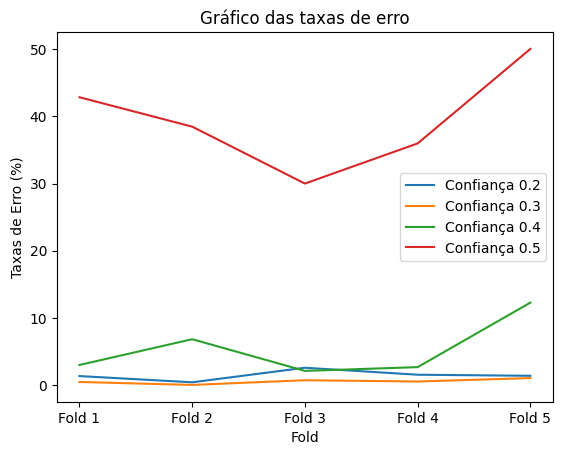

In [ ]:
grafico1(val20, val30, val40, val50)

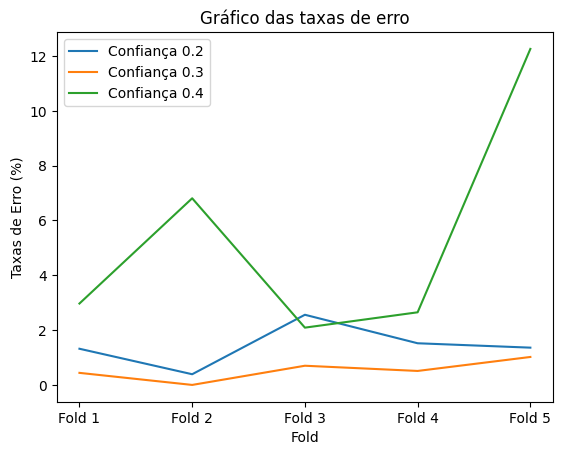

In [ ]:
grafico2(val20, val30, val40)

#Medidas de avaliação

In [ ]:
prec1_20, rec1_20 = precision_recall('/content/drive/MyDrive/qtd_carros/fold1', '/content/drive/MyDrive/Testes/teste_fold1_20/labels', 0.2)
f1_20 = f1_score(prec1_20, rec1_20, 0.2)
prec1_30, rec1_30 = precision_recall('/content/drive/MyDrive/qtd_carros/fold1', '/content/drive/MyDrive/Testes/teste_fold1_30/labels', 0.3)
f1_30 = f1_score(prec1_30, rec1_30, 0.3)
prec1_40, rec1_40 = precision_recall('/content/drive/MyDrive/qtd_carros/fold1', '/content/drive/MyDrive/Testes/teste_fold1_40/labels', 0.4)
f1_40 = f1_score(prec1_40, rec1_40, 0.4)
prec1_50, rec1_50 = precision_recall('/content/drive/MyDrive/qtd_carros/fold1', '/content/drive/MyDrive/Testes/teste_fold1_50/labels', 0.5)
f1_50 = f1_score(prec1_50, rec1_50, 0.5)

FOLD: /content/drive/MyDrive/qtd_carros/fold1
Precision (CONF == 0.2) = 98.7 %
Recall (CONF == 0.2) = 100.0 %
F1_Score (CONF == 0.2) = 99.35 %
FOLD: /content/drive/MyDrive/qtd_carros/fold1
Precision (CONF == 0.3) = 99.56 %
Recall (CONF == 0.3) = 100.0 %
F1_Score (CONF == 0.3) = 99.78 %
FOLD: /content/drive/MyDrive/qtd_carros/fold1
Precision (CONF == 0.4) = 100.0 %
Recall (CONF == 0.4) = 97.03 %
F1_Score (CONF == 0.4) = 98.49 %
FOLD: /content/drive/MyDrive/qtd_carros/fold1
Precision (CONF == 0.5) = 100.0 %
Recall (CONF == 0.5) = 57.14 %
F1_Score (CONF == 0.5) = 72.72 %


In [ ]:
prec2_20, rec2_20 = precision_recall('/content/drive/MyDrive/qtd_carros/fold2', '/content/drive/MyDrive/Testes/teste_fold2_20/labels', 0.2)
f2_20 = f1_score(prec2_20, rec2_20, 0.2)
prec2_30, rec2_30 = precision_recall('/content/drive/MyDrive/qtd_carros/fold2', '/content/drive/MyDrive/Testes/teste_fold2_30/labels', 0.3)
f2_30 = f1_score(prec2_30, rec2_30, 0.2)
prec2_40, rec2_40 = precision_recall('/content/drive/MyDrive/qtd_carros/fold2', '/content/drive/MyDrive/Testes/teste_fold2_40/labels', 0.4)
f2_40 = f1_score(prec2_40, rec2_40, 0.2)
prec2_50, rec2_50 = precision_recall('/content/drive/MyDrive/qtd_carros/fold2', '/content/drive/MyDrive/Testes/teste_fold2_50/labels', 0.5)
f2_50 = f1_score(prec2_50, rec2_50, 0.5)

FOLD: /content/drive/MyDrive/qtd_carros/fold2
Precision (CONF == 0.2) = 99.61 %
Recall (CONF == 0.2) = 100.0 %
F1_Score (CONF == 0.2) = 99.8 %
FOLD: /content/drive/MyDrive/qtd_carros/fold2
Precision (CONF == 0.3) = 100.0 %
Recall (CONF == 0.3) = 100.0 %
F1_Score (CONF == 0.2) = 100.0 %
FOLD: /content/drive/MyDrive/qtd_carros/fold2
Precision (CONF == 0.4) = 100.0 %
Recall (CONF == 0.4) = 93.19 %
F1_Score (CONF == 0.2) = 96.47 %
FOLD: /content/drive/MyDrive/qtd_carros/fold2
Precision (CONF == 0.5) = 100.0 %
Recall (CONF == 0.5) = 61.52 %
F1_Score (CONF == 0.5) = 76.18 %


In [ ]:
prec3_20, rec3_20 = precision_recall('/content/drive/MyDrive/qtd_carros/fold3', '/content/drive/MyDrive/Testes/teste_fold3_20/labels', 0.2)
f3_20 = f1_score(prec3_20, rec3_20, 0.2)
prec3_30, rec3_30 = precision_recall('/content/drive/MyDrive/qtd_carros/fold3', '/content/drive/MyDrive/Testes/teste_fold3_30/labels', 0.3)
f3_30 = f1_score(prec3_30, rec3_30, 0.3)
prec3_40, rec3_40 = precision_recall('/content/drive/MyDrive/qtd_carros/fold3', '/content/drive/MyDrive/Testes/teste_fold3_40/labels', 0.4)
f3_40 = f1_score(prec3_40, rec3_40, 0.4)
prec3_50, rec3_50 = precision_recall('/content/drive/MyDrive/qtd_carros/fold3', '/content/drive/MyDrive/Testes/teste_fold3_50/labels', 0.5)
f3_50 = f1_score(prec3_50, rec3_50, 0.5)

FOLD: /content/drive/MyDrive/qtd_carros/fold3
Precision (CONF == 0.2) = 97.61 %
Recall (CONF == 0.2) = 99.88 %
F1_Score (CONF == 0.2) = 98.73 %
FOLD: /content/drive/MyDrive/qtd_carros/fold3
Precision (CONF == 0.3) = 99.54 %
Recall (CONF == 0.3) = 99.77 %
F1_Score (CONF == 0.3) = 99.65 %
FOLD: /content/drive/MyDrive/qtd_carros/fold3
Precision (CONF == 0.4) = 99.88 %
Recall (CONF == 0.4) = 98.02 %
F1_Score (CONF == 0.4) = 98.94 %
FOLD: /content/drive/MyDrive/qtd_carros/fold3
Precision (CONF == 0.5) = 100.0 %
Recall (CONF == 0.5) = 70.0 %
F1_Score (CONF == 0.5) = 82.35 %


In [ ]:
prec4_20, rec4_20 = precision_recall('/content/drive/MyDrive/qtd_carros/fold4', '/content/drive/MyDrive/Testes/teste_fold4_20/labels', 0.2)
f4_20 = f1_score(prec4_20, rec4_20, 0.2)
prec4_30, rec4_30 = precision_recall('/content/drive/MyDrive/qtd_carros/fold4', '/content/drive/MyDrive/Testes/teste_fold4_30/labels', 0.3)
f4_30 = f1_score(prec4_30, rec4_30, 0.3)
prec4_40, rec4_40 = precision_recall('/content/drive/MyDrive/qtd_carros/fold4', '/content/drive/MyDrive/Testes/teste_fold4_40/labels', 0.4)
f4_40 = f1_score(prec4_40, rec4_40, 0.4)
prec4_50, rec4_50 = precision_recall('/content/drive/MyDrive/qtd_carros/fold4', '/content/drive/MyDrive/Testes/teste_fold4_50/labels', 0.5)
f4_50 = f1_score(prec4_50, rec4_50, 0.5)

FOLD: /content/drive/MyDrive/qtd_carros/fold4
Precision (CONF == 0.2) = 98.51 %
Recall (CONF == 0.2) = 100.0 %
F1_Score (CONF == 0.2) = 99.25 %
FOLD: /content/drive/MyDrive/qtd_carros/fold4
Precision (CONF == 0.3) = 99.5 %
Recall (CONF == 0.3) = 100.0 %
F1_Score (CONF == 0.3) = 99.75 %
FOLD: /content/drive/MyDrive/qtd_carros/fold4
Precision (CONF == 0.4) = 100.0 %
Recall (CONF == 0.4) = 97.35 %
F1_Score (CONF == 0.4) = 98.66 %
FOLD: /content/drive/MyDrive/qtd_carros/fold4
Precision (CONF == 0.5) = 100.0 %
Recall (CONF == 0.5) = 64.02 %
F1_Score (CONF == 0.5) = 78.06 %


In [ ]:
prec5_20, rec5_20 = precision_recall('/content/drive/MyDrive/qtd_carros/fold5', '/content/drive/MyDrive/Testes/teste_fold5_20/labels', 0.2)
f5_20 = f1_score(prec5_20, rec5_20, 0.2)
prec5_30, rec5_30 = precision_recall('/content/drive/MyDrive/qtd_carros/fold5', '/content/drive/MyDrive/Testes/teste_fold5_30/labels', 0.3)
f5_30 = f1_score(prec5_30, rec5_30, 0.3)
prec5_40, rec5_40 = precision_recall('/content/drive/MyDrive/qtd_carros/fold5', '/content/drive/MyDrive/Testes/teste_fold5_40/labels', 0.4)
f5_40 = f1_score(prec5_40, rec5_40, 0.4)
prec5_50, rec5_50 = precision_recall('/content/drive/MyDrive/qtd_carros/fold5', '/content/drive/MyDrive/Testes/teste_fold5_50/labels', 0.5)
f5_50 = f1_score(prec5_50, rec5_50, 0.5)

FOLD: /content/drive/MyDrive/qtd_carros/fold5
Precision (CONF == 0.2) = 98.77 %
Recall (CONF == 0.2) = 99.89 %
F1_Score (CONF == 0.2) = 99.33 %
FOLD: /content/drive/MyDrive/qtd_carros/fold5
Precision (CONF == 0.3) = 99.21 %
Recall (CONF == 0.3) = 99.77 %
F1_Score (CONF == 0.3) = 99.49 %
FOLD: /content/drive/MyDrive/qtd_carros/fold5
Precision (CONF == 0.4) = 100.0 %
Recall (CONF == 0.4) = 87.74 %
F1_Score (CONF == 0.4) = 93.47 %
FOLD: /content/drive/MyDrive/qtd_carros/fold5
Precision (CONF == 0.5) = 100.0 %
Recall (CONF == 0.5) = 49.94 %
F1_Score (CONF == 0.5) = 66.61 %


In [ ]:
prec20 = [prec1_20, prec2_20, prec3_20, prec4_20, prec5_20]
prec30 = [prec1_30, prec2_30, prec3_30, prec4_30, prec5_30]
prec40 = [prec1_40, prec2_40, prec3_40, prec4_40, prec5_40]
prec50 = [prec1_50, prec2_50, prec3_50, prec4_50, prec5_50]
print("--------PRECISION---------")
media_desvio(prec20, 0.2)
print("--------------------------")
media_desvio(prec30, 0.3)
print("--------------------------")
media_desvio(prec40, 0.4)
print("--------------------------")
media_desvio(prec50, 0.5)
print("--------------------------")

--------PRECISION---------
Confiança =  0.2
Média =  98.64 %
Desvio padrão =  0.64 %
--------------------------
Confiança =  0.3
Média =  99.56 %
Desvio padrão =  0.25 %
--------------------------
Confiança =  0.4
Média =  99.98 %
Desvio padrão =  0.05 %
--------------------------
Confiança =  0.5
Média =  100.0 %
Desvio padrão =  0.0 %
--------------------------


In [ ]:
rec20 = [rec1_20, rec2_20, rec3_20, rec4_20, rec5_20]
rec30 = [rec1_30, rec2_30, rec3_30, rec4_30, rec5_30]
rec40 = [rec1_40, rec2_40, rec3_40, rec4_40, rec5_40]
rec50 = [rec1_50, rec2_50, rec3_50, rec4_50, rec5_50]
print("----------RECALL----------")
media_desvio(rec20, 0.2)
print("--------------------------")
media_desvio(rec30, 0.3)
print("--------------------------")
media_desvio(rec40, 0.4)
print("--------------------------")
media_desvio(rec50, 0.5)
print("--------------------------")

----------RECALL----------
Confiança =  0.2
Média =  99.95 %
Desvio padrão =  0.06 %
--------------------------
Confiança =  0.3
Média =  99.91 %
Desvio padrão =  0.11 %
--------------------------
Confiança =  0.4
Média =  94.67 %
Desvio padrão =  3.85 %
--------------------------
Confiança =  0.5
Média =  60.52 %
Desvio padrão =  6.73 %
--------------------------


In [ ]:
f20 = [f1_20, f2_20, f3_20, f4_20, f5_20]
f30 = [f1_30, f2_30, f3_30, f4_30, f5_30]
f40 = [f1_40, f2_40, f3_40, f4_40, f5_40]
f50 = [f1_50, f2_50, f3_50, f4_50, f5_50]
print("---------F1_Score---------")
media_desvio(f20, 0.2)
print("--------------------------")
media_desvio(f30, 0.3)
print("--------------------------")
media_desvio(f40, 0.4)
print("--------------------------")
media_desvio(f50, 0.5)
print("--------------------------")

---------F1_Score---------
Confiança =  0.2
Média =  99.29 %
Desvio padrão =  0.34 %
--------------------------
Confiança =  0.3
Média =  99.73 %
Desvio padrão =  0.17 %
--------------------------
Confiança =  0.4
Média =  97.21 %
Desvio padrão =  2.06 %
--------------------------
Confiança =  0.5
Média =  75.18 %
Desvio padrão =  5.3 %
--------------------------


#Gráficos 2

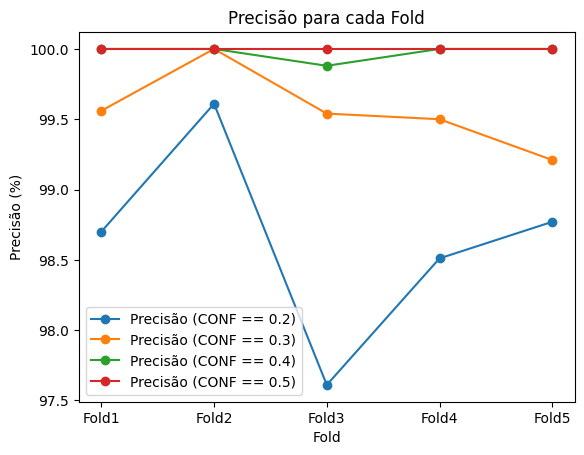

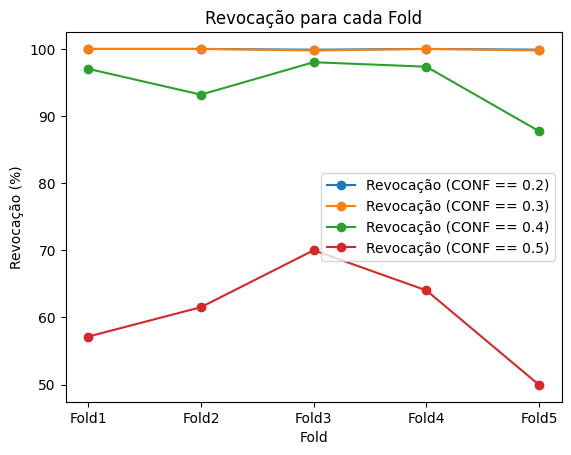

In [ ]:
conf = [0.2, 0.3, 0.4, 0.5]
grafico3([prec20, prec30, prec40, prec50], [rec20, rec30, rec40, rec50], conf)

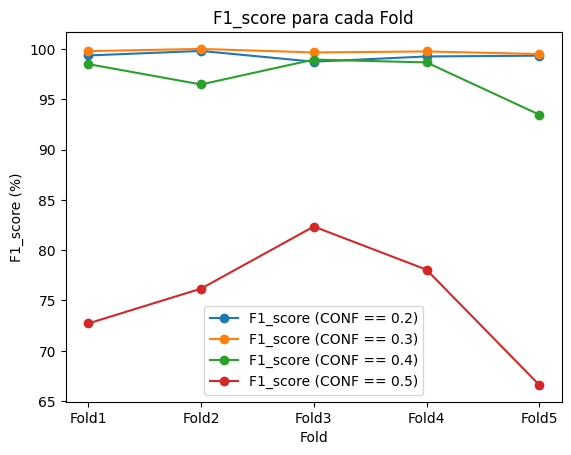

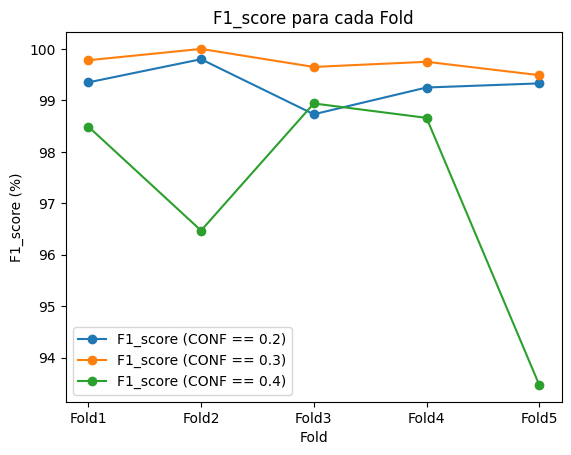

In [ ]:
conf = [0.2, 0.3, 0.4, 0.5]
grafico4([f20, f30, f40, f50], conf)
conf2 = [0.2, 0.3, 0.4]
grafico4([f20, f30, f40], conf2)

#Teste de verificação de sobreposição

Essa parte é apenas um teste para entender como verificar a sobreposição -- Não é otimizado pois precisa ficar copiando as pastas do drive pro colab (ineficaz)

In [ ]:
def copy_files_with_substring(dir_path, target_path, substring):
  for filename in os.listdir(dir_path):
        if os.path.isfile(os.path.join(dir_path, filename)) and substring in filename:
            src_file = os.path.join(dir_path, filename)
            dest_file = os.path.join(target_path, filename)
            shutil.copy(src_file, dest_file)
            print(f"Copied file '{filename}' to directory '{target_path}'")

In [ ]:
def limparDir(dir_path):
  for filename in os.listdir(dir_path):
        file_path = os.path.join(dir_path, filename)
        if os.path.isfile(file_path):
            os.remove(file_path)
            print(f"Deleted file: {file_path}")
        elif os.path.isdir(file_path):
            shutil.rmtree(file_path)
            print(f"Deleted directory: {file_path}")

In [ ]:
def read_coordinates(file_path):
    with open(file_path, 'r') as file:
        coordinates = []
        for line in file:
            parts = line.strip().split()
            if len(parts) == 5:
                x = float(parts[1])
                y = float(parts[2])
                width = float(parts[3])
                height = float(parts[4])
                coordinates.append((x, y, width, height))
    return coordinates

In [ ]:
def check_overlap(coord1, coord2):
    x1, y1, w1, h1 = coord1
    x2, y2, w2, h2 = coord2
    if x1 < x2 + w2 and x1 + w1 > x2 and y1 < y2 + h2 and y1 + h1 > y2:
        return True
    return False

In [ ]:
def count_filled_vagas(file_path, a3vid5_coordinates):
    filled_vagas = 0
    with open(file_path, 'r') as file:
        for line in file:
            parts = line.strip().split()
            if len(parts) == 5:
                coordinates = [float(coord) for coord in parts[1:]]
                for a3vid5_coord in a3vid5_coordinates:
                    if check_overlap(coordinates, a3vid5_coord):
                        filled_vagas += 1
                        break
    return filled_vagas

In [ ]:
dir1 = '/content/drive/MyDrive/Testes/teste_fold1_30/labels'
dir2 = '/content/drive/MyDrive/Testes/teste_fold2_30/labels'
dir3 = '/content/drive/MyDrive/Testes/teste_fold3_30/labels'
dir4 = '/content/drive/MyDrive/Testes/teste_fold4_30/labels'
dir5 = '/content/drive/MyDrive/Testes/teste_fold5_30/labels'

In [ ]:
dirs = [dir1, dir2, dir3, dir4, dir5]

In [ ]:
target1 = '/content/A2vid1'
target2 = '/content/A2vid2'
target3 = '/content/A2vid3'
target4 = '/content/A3vid1'
target5 = '/content/A3vid2'
target6 = '/content/A3vid3'
target7 = '/content/A3vid4'
target8 = '/content/A3vid5'

In [ ]:
s1 = 'A2vid1'
s2 = 'A2vid2'
s3 = 'A2vid3'
s4 = 'A3vid1'
s5 = 'A3vid2'
s6 = 'A3vid3'
s7 = 'A3vid4'
s8 = 'A3vid5'

In [ ]:
targ = [target1, target2, target3, target4, target5, target6, target7, target8]
ss = [s1, s2, s3, s4, s5, s6, s7, s8]
dd = dir1

In [ ]:
for t in targ:
  if not os.path.exists(t):
    os.makedirs(t)
  limparDir(t)

In [ ]:
for t, s in zip(targ, ss):
  copy_files_with_substring(dir1, t, s)

Copied file 'A2vid1_frame_11.txt' to directory '/content/A2vid1'
Copied file 'A2vid1_frame_4.txt' to directory '/content/A2vid1'
Copied file 'A2vid2_frame_12.txt' to directory '/content/A2vid2'
Copied file 'A2vid2_frame_15.txt' to directory '/content/A2vid2'
Copied file 'A2vid2_frame_18.txt' to directory '/content/A2vid2'
Copied file 'A2vid2_frame_20.txt' to directory '/content/A2vid2'
Copied file 'A2vid2_frame_32.txt' to directory '/content/A2vid2'
Copied file 'A2vid2_frame_4.txt' to directory '/content/A2vid2'
Copied file 'A2vid2_frame_5.txt' to directory '/content/A2vid2'
Copied file 'A2vid2_frame_9.txt' to directory '/content/A2vid2'
Copied file 'A2vid3_frame_0.txt' to directory '/content/A2vid3'
Copied file 'A2vid3_frame_2.txt' to directory '/content/A2vid3'
Copied file 'A2vid3_frame_5.txt' to directory '/content/A2vid3'
Copied file 'A3vid1_frame_11.txt' to directory '/content/A3vid1'
Copied file 'A3vid1_frame_12.txt' to directory '/content/A3vid1'
Copied file 'A3vid1_frame_17.txt

In [ ]:
def count_total_vagas(file_path):
    with open(file_path, 'r') as file:
        total_vagas = sum(1 for line in file)
    return total_vagas

def count_total_carros(file_path):
    with open(file_path, 'r') as file:
        total_carros = sum(1 for line in file)
    return total_carros

def return_overlap():
  a3vid5_file_path = "/content/drive/MyDrive/BBOX+TAMIMG/A2vid1.txt"
  directory_path = "/content/A2vid1/"

  a3vid5_coordinates = read_coordinates(a3vid5_file_path)

  total_vagas = count_total_vagas(a3vid5_file_path)
  total_carros = 0
  total_filled_vagas = 0
  file_count = 0

  for filename in os.listdir(directory_path):
      if filename.endswith(".txt"):
          file_count += 1
          current_file_path = os.path.join(directory_path, filename)

          filled_vagas = count_filled_vagas(current_file_path, a3vid5_coordinates)
          total_filled_vagas += filled_vagas

          carros = count_total_carros(current_file_path)
          total_carros += carros

          '''
          print(f"Arquivo: {filename}")
          print(f"Total de vagas: {total_vagas}")
          print(f"Total de carros: {carros}")
          print(f"Vagas preenchidas: {filled_vagas} / {total_vagas}")
          print(f"Vagas vazias: {total_vagas - filled_vagas} / {total_vagas}")
          print()
          '''

          return filled_vagas, (total_vagas - filled_vagas)

fim

In [ ]:
def tabelaA2(caminho_imagem, caminho_arquivo):

    tabela = cv2.imread("/content/drive/MyDrive/ImagensTabela/tabela.jpg")

    imagem_estacionamento = cv2.imread(caminho_imagem)

    carros = contar_linhas_arquivo(caminho_arquivo)
    vagasocup, vagasdisp = return_overlap()

    # Definir fonte e tamanho do texto
    fonte = cv2.FONT_HERSHEY_SIMPLEX
    escala_texto = 1.2
    espessura_texto = 3

    # Escrever os dados da tabela na imagem do estacionamento
    texto_vagasdisp = f"Vagas disponiveis: {vagasdisp}"
    texto_vagasocup = f"Vagas ocupadas: {vagasocup}"
    texto_carros = f"Carros aqui: {carros}"

    coordenadas_texto_vagasdisp = (10, 330)  # Coordenadas para posicionar o texto dos carros
    coordenadas_texto_vagasocup = (10, 370)   # Coordenadas para posicionar o texto das vagas
    coordenadas_texto_carros = (10, 410)   # Coordenadas para posicionar o texto das vagas
    cv2.putText(imagem_estacionamento, texto_vagasdisp, coordenadas_texto_vagasdisp, fonte, escala_texto, (255, 0, 0), espessura_texto)
    cv2.putText(imagem_estacionamento, texto_vagasocup, coordenadas_texto_vagasocup, fonte, escala_texto, (255, 0, 0), espessura_texto)
    cv2.putText(imagem_estacionamento, texto_carros, coordenadas_texto_carros, fonte, escala_texto, (255, 0, 0), espessura_texto)

    # Exibir a imagem com a tabela
    cv2_imshow(imagem_estacionamento)

In [ ]:
def tabelaA3(caminho_imagem, caminho_arquivo):

    tabela = cv2.imread("/content/drive/MyDrive/ImagensTabela/tabela.jpg")

    imagem_estacionamento = cv2.imread(caminho_imagem)

    carros = contar_linhas_arquivo(caminho_arquivo)
    vagasdisp = 60
    vagasocup = 60

    # Definir fonte e tamanho do texto
    fonte = cv2.FONT_HERSHEY_SIMPLEX
    escala_texto = 1.2
    espessura_texto = 3

    # Escrever os dados da tabela na imagem do estacionamento
    texto_vagasdisp = f"Vagas disponiveis: {vagasocup}"
    texto_vagasocup = f"Vagas ocupadas: {vagasocup}"
    texto_carros = f"Carros: {carros}"

    coordenadas_texto_vagasdisp = (10, 200)  # Coordenadas para posicionar o texto dos carros
    coordenadas_texto_vagasocup = (10, 240)   # Coordenadas para posicionar o texto das vagas
    coordenadas_texto_carros = (10, 280)   # Coordenadas para posicionar o texto das vagas
    cv2.putText(imagem_estacionamento, texto_vagasdisp, coordenadas_texto_vagasdisp, fonte, escala_texto, (255, 0, 0), espessura_texto)
    cv2.putText(imagem_estacionamento, texto_vagasocup, coordenadas_texto_vagasocup, fonte, escala_texto, (255, 0, 0), espessura_texto)
    cv2.putText(imagem_estacionamento, texto_carros, coordenadas_texto_carros, fonte, escala_texto, (255, 0, 0), espessura_texto)

    # Exibir a imagem com a tabela
    cv2_imshow(imagem_estacionamento)

In [ ]:
def teste(pasta_teste):
    for filename in os.listdir(pasta_teste):
        caminho_imagem = os.path.join(pasta_teste, filename)
        if filename.endswith('.jpg'):
            nome_base = os.path.splitext(filename)[0]
            caminho_pasta_arquivo = os.path.join(pasta_teste, "labels", nome_base)
            caminho_arquivo = caminho_pasta_arquivo + ".txt"
            if filename.startswith("A2"):
                tabelaA2(caminho_imagem, caminho_arquivo)
            '''
            if filename.startswith("A3"):
                tabelaA3(caminho_imagem, caminho_arquivo)
            '''

In [ ]:
filled = return_overlap();
print(filled)

(36, 18)


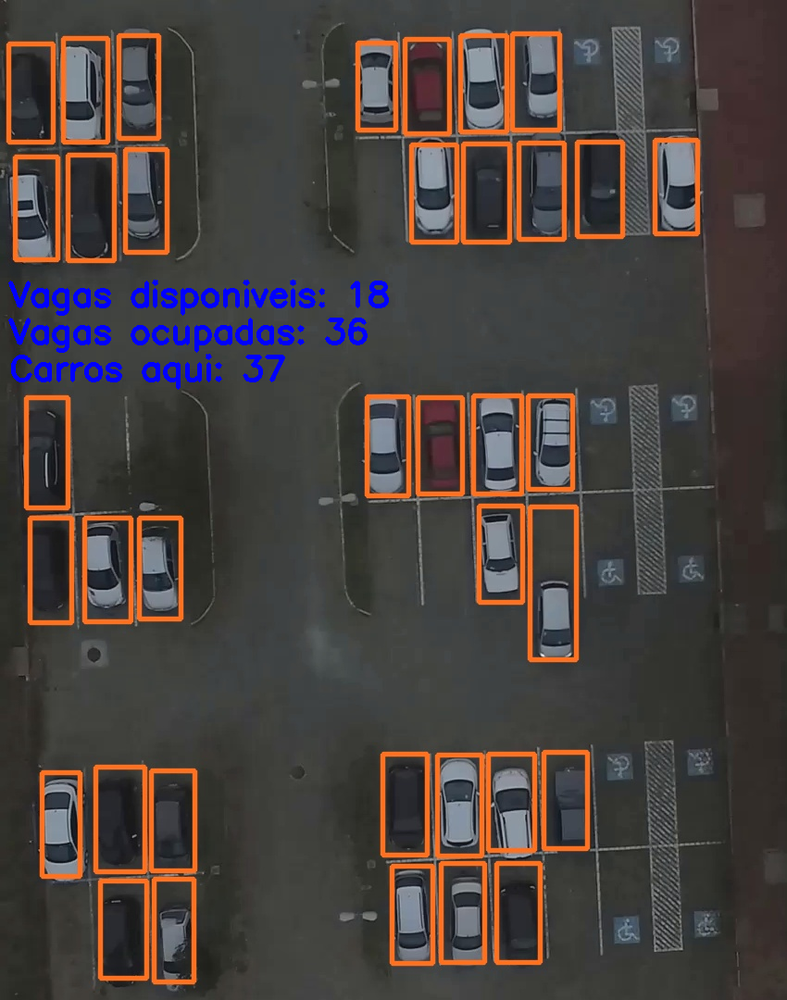

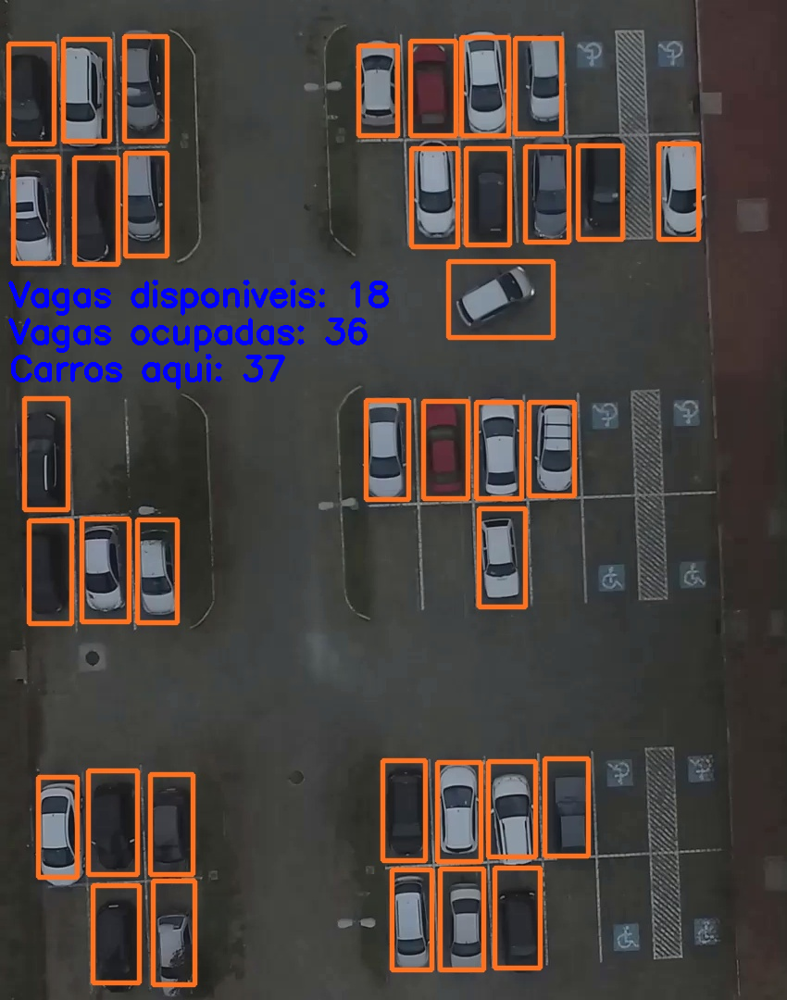

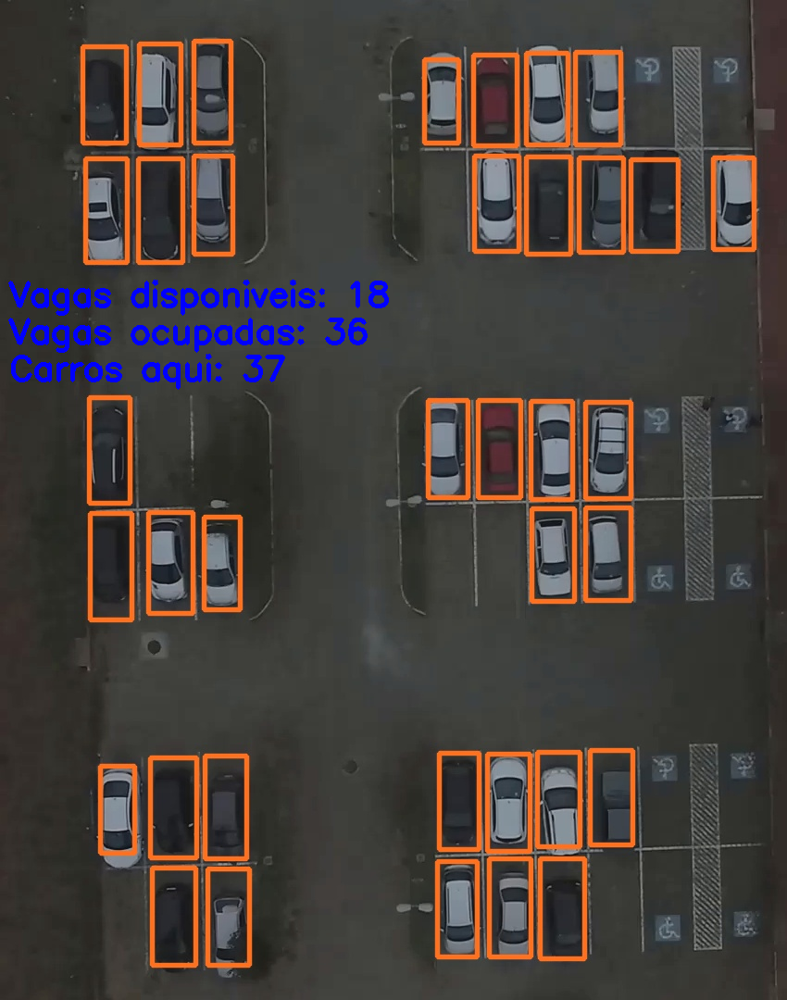

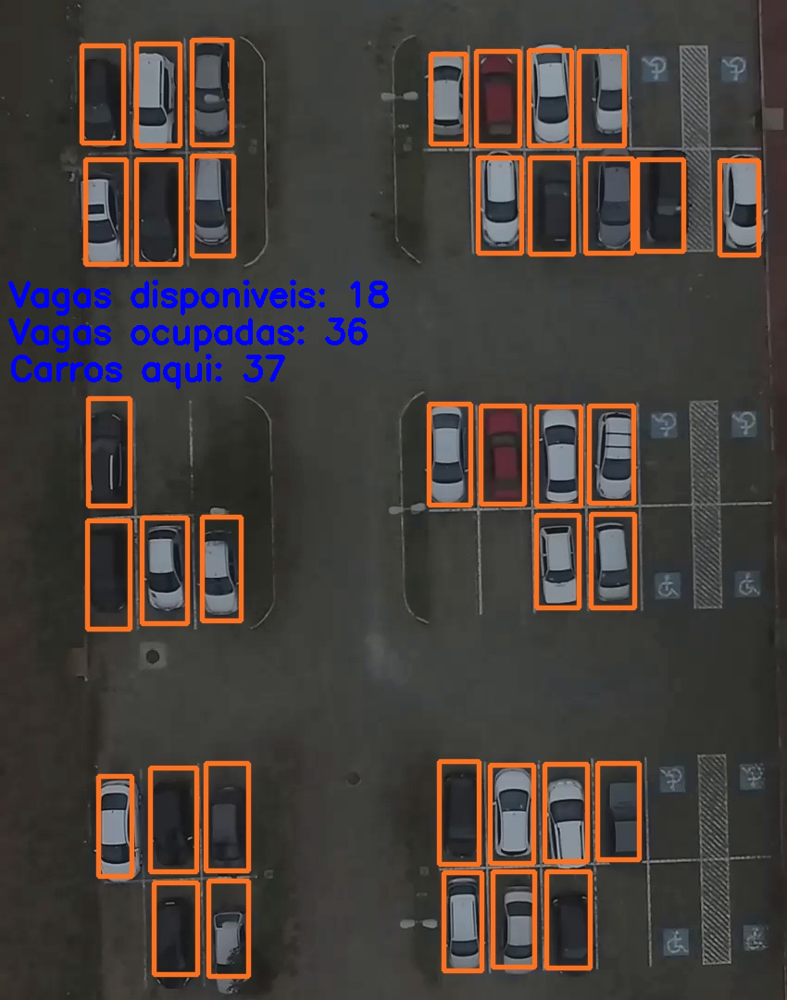

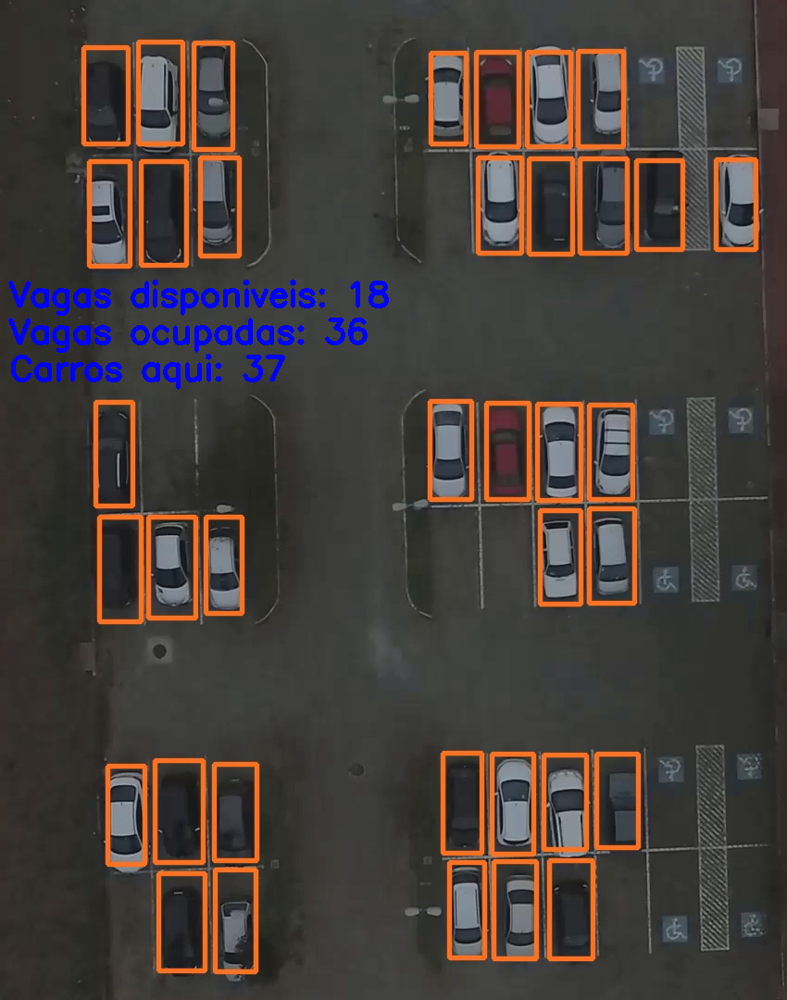

...

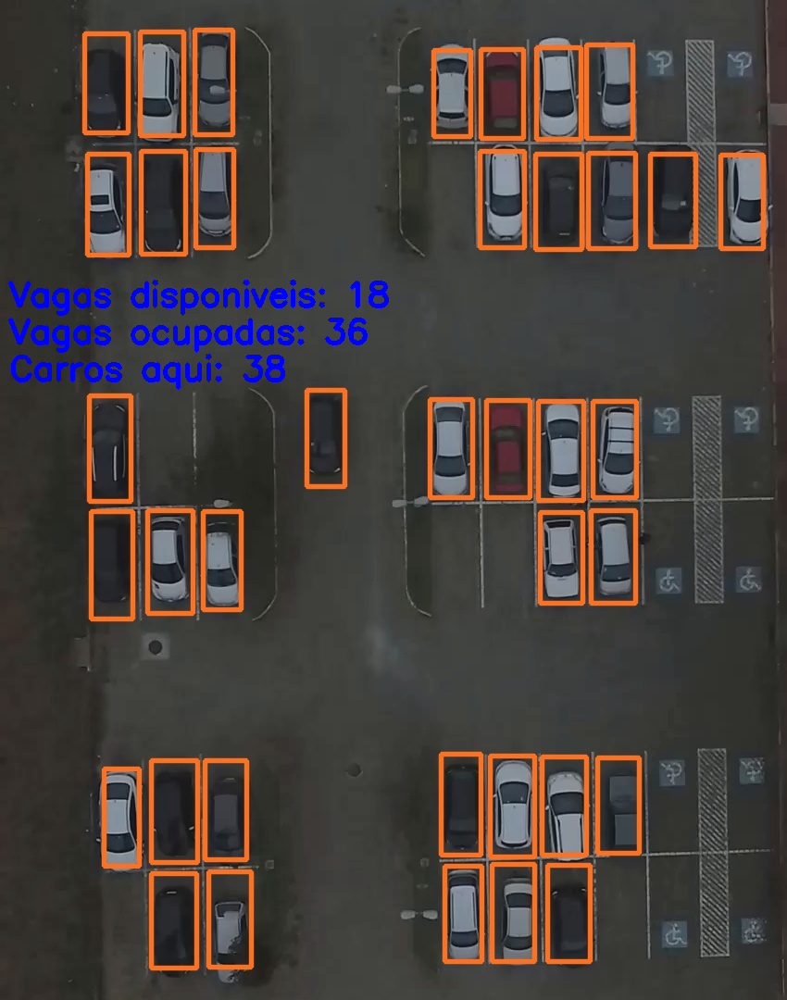

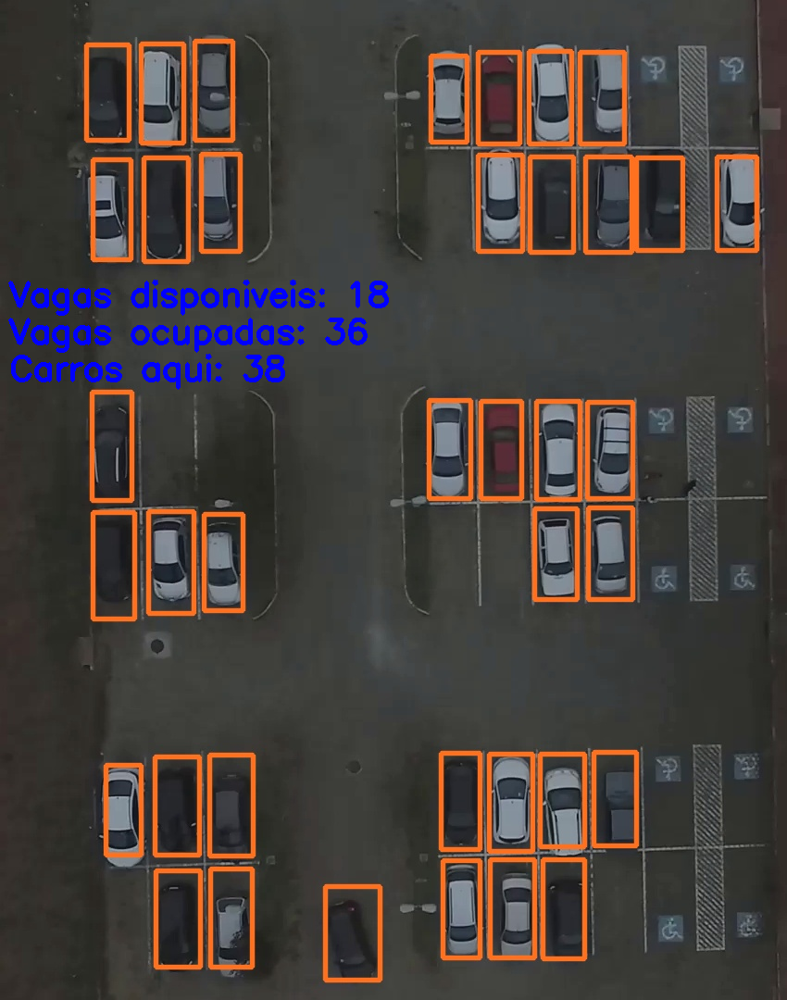

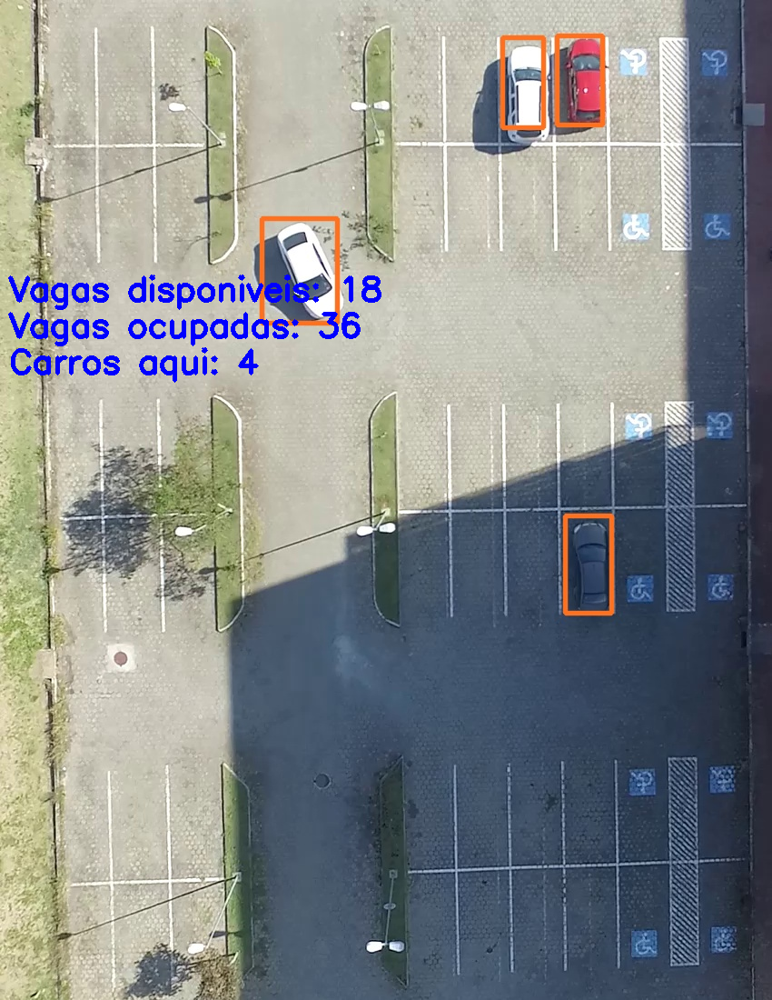

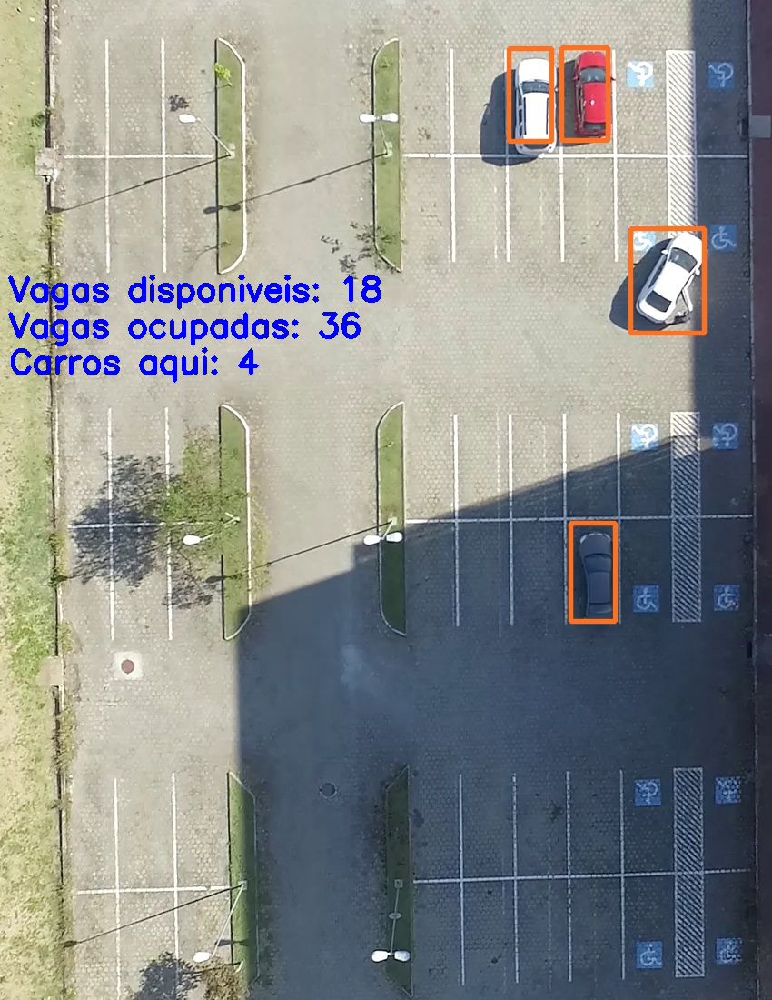

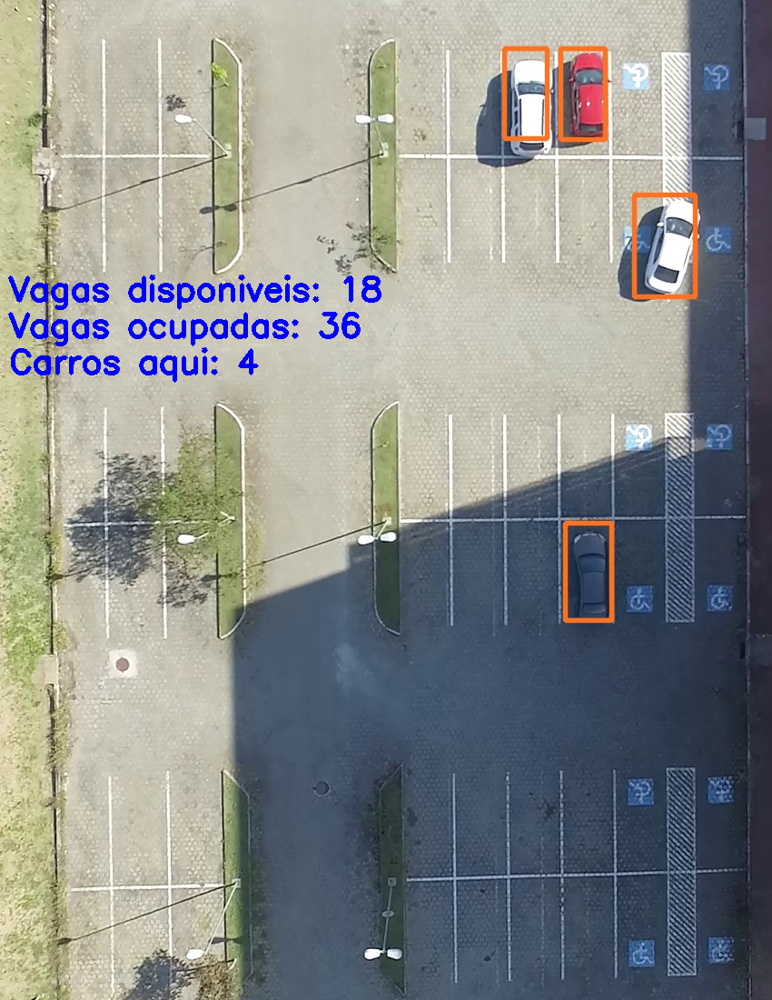

In [ ]:
fold = '/content/drive/MyDrive/Testes/teste_fold1_30'
teste(fold)

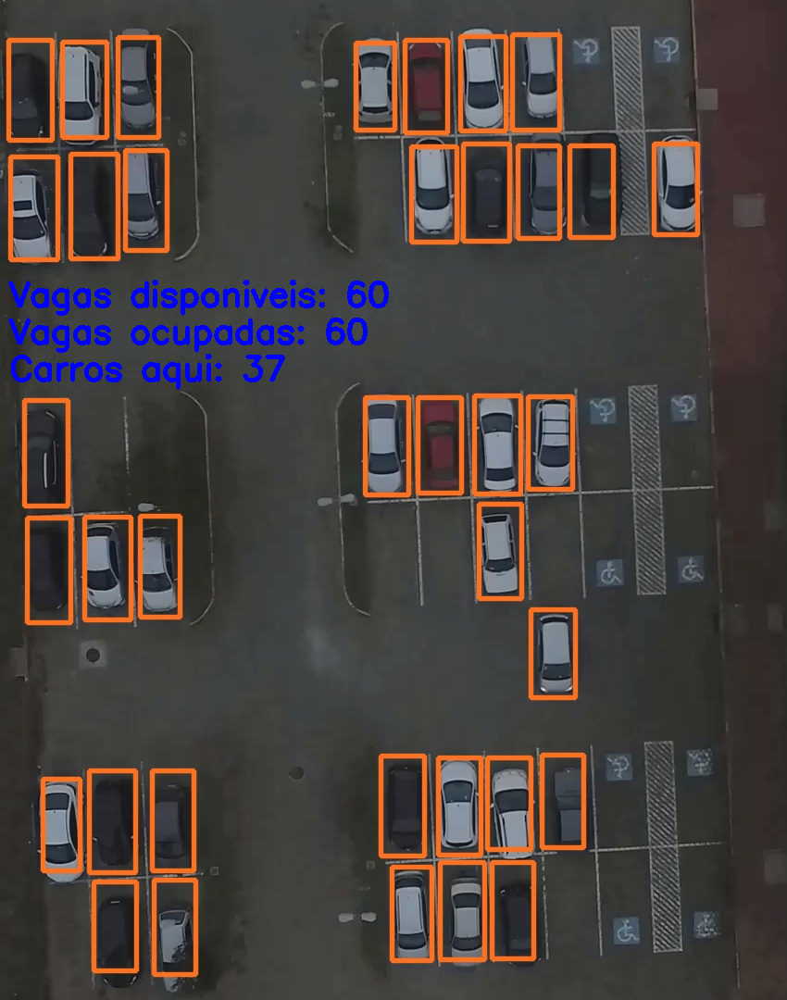

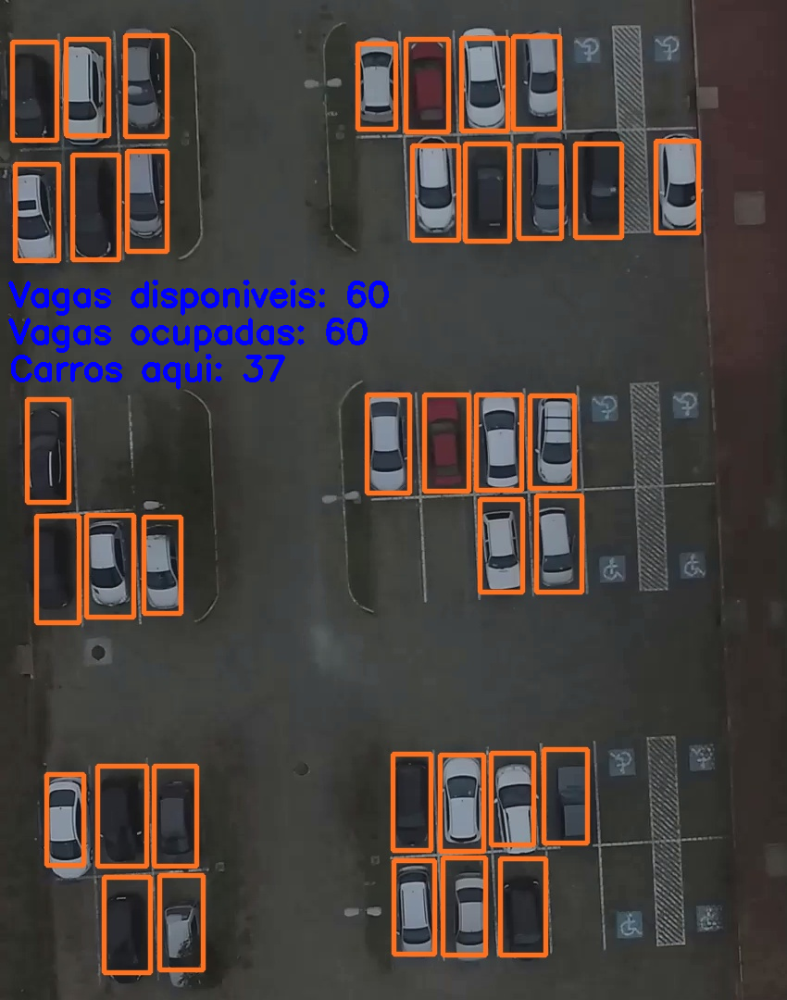

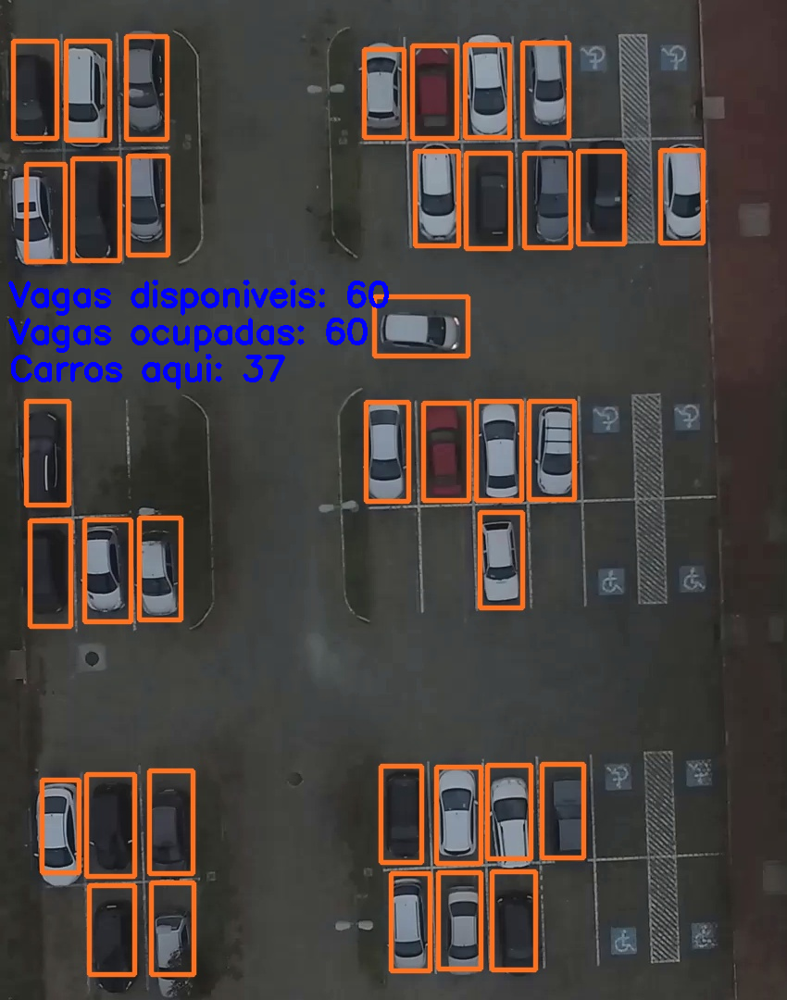

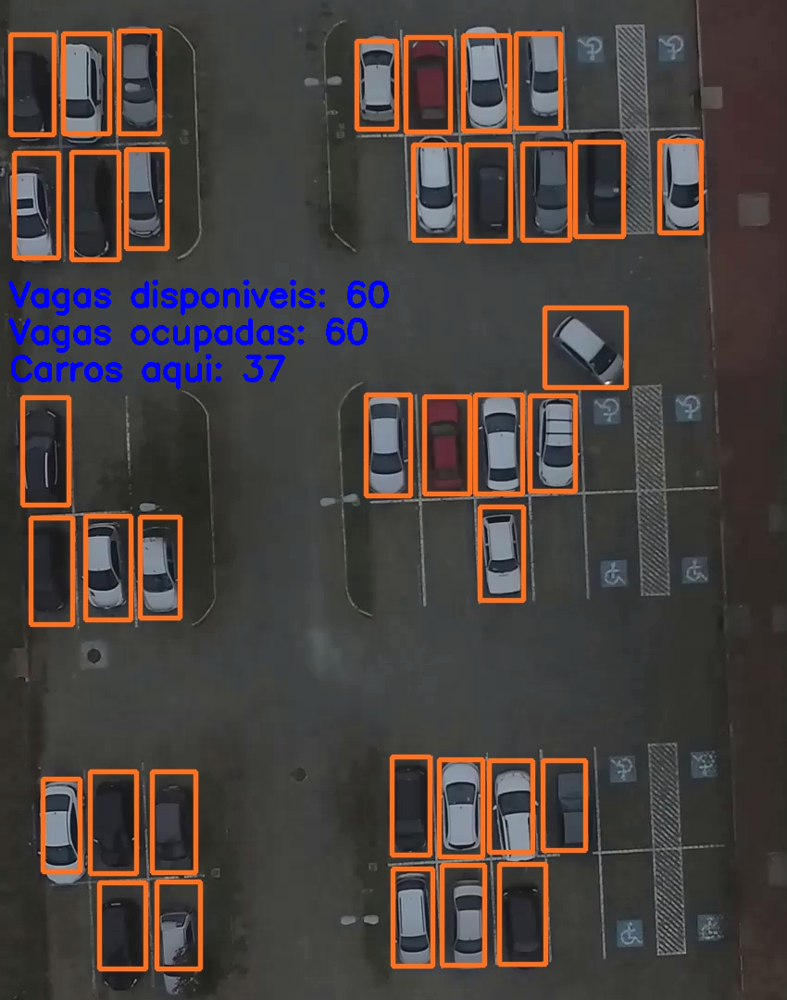

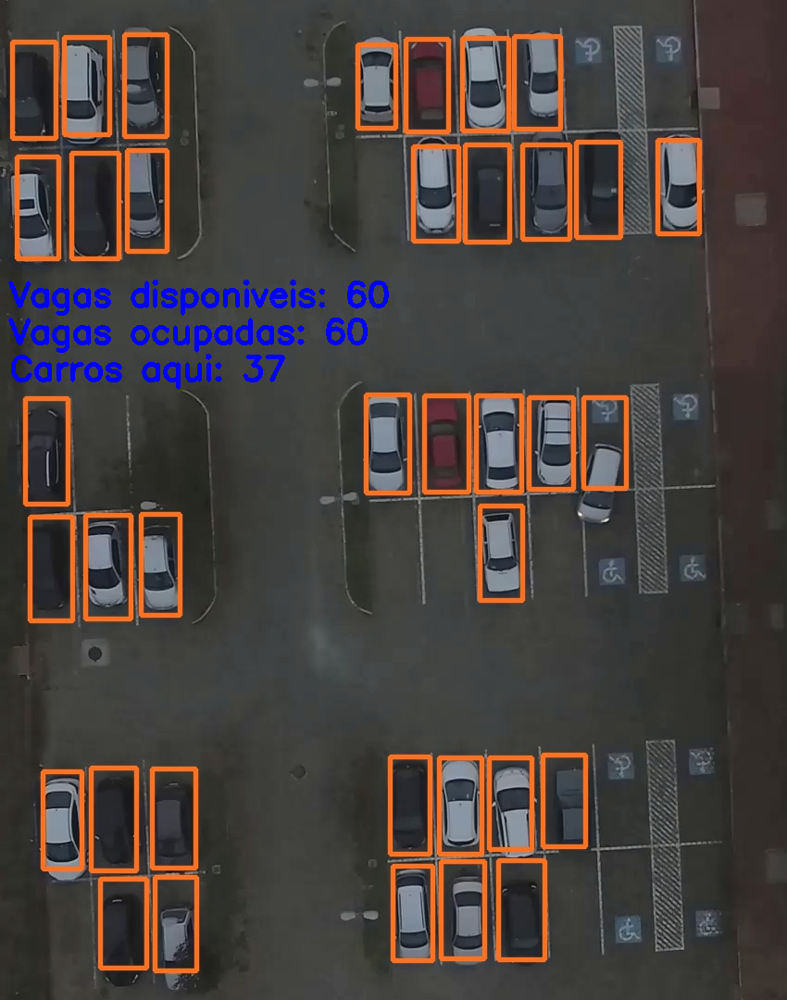

...

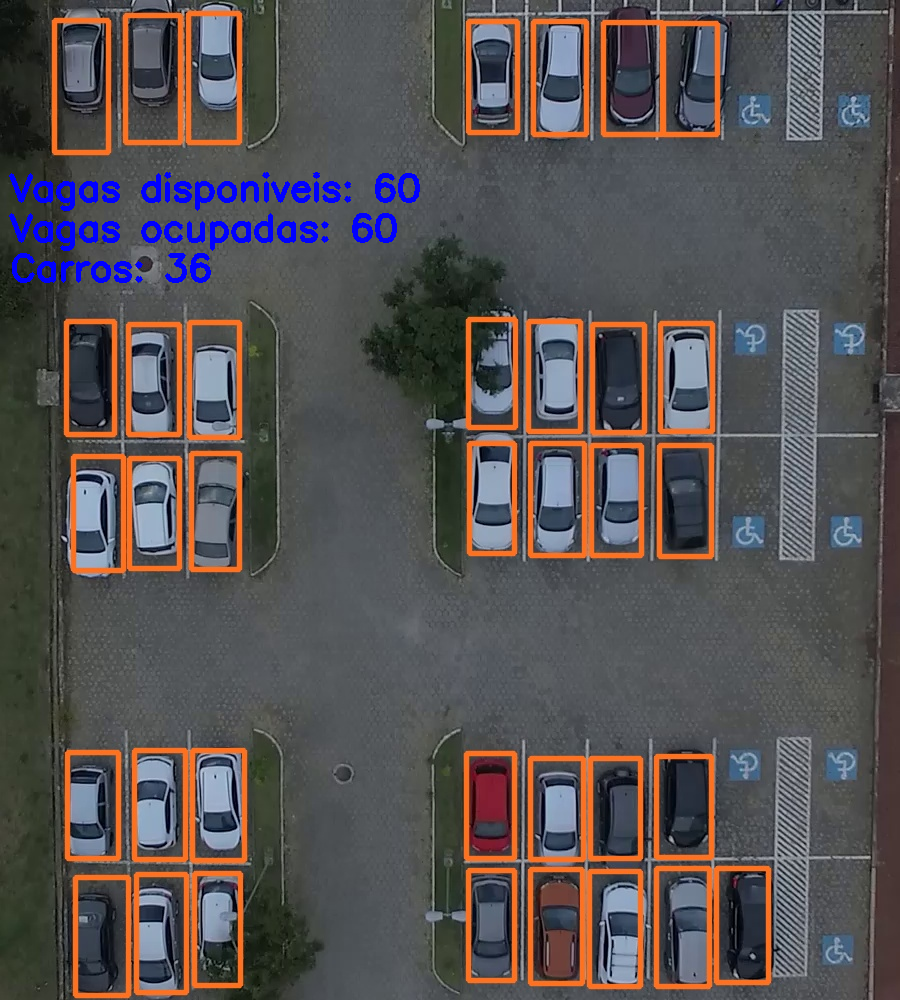

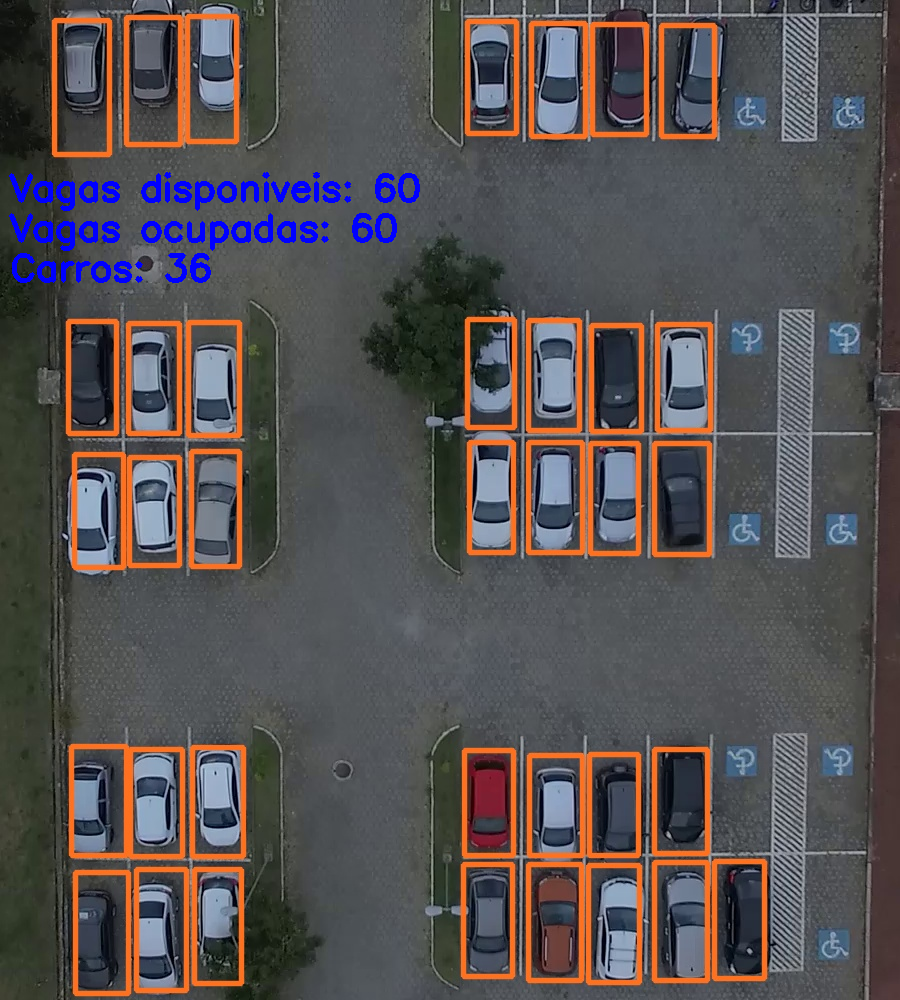

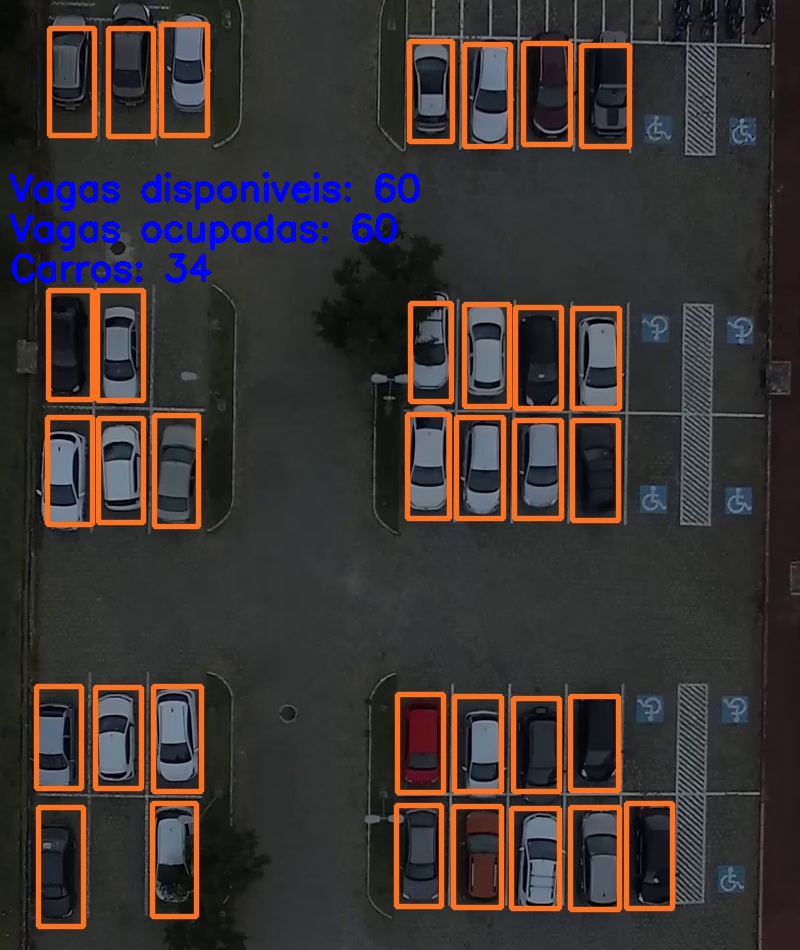

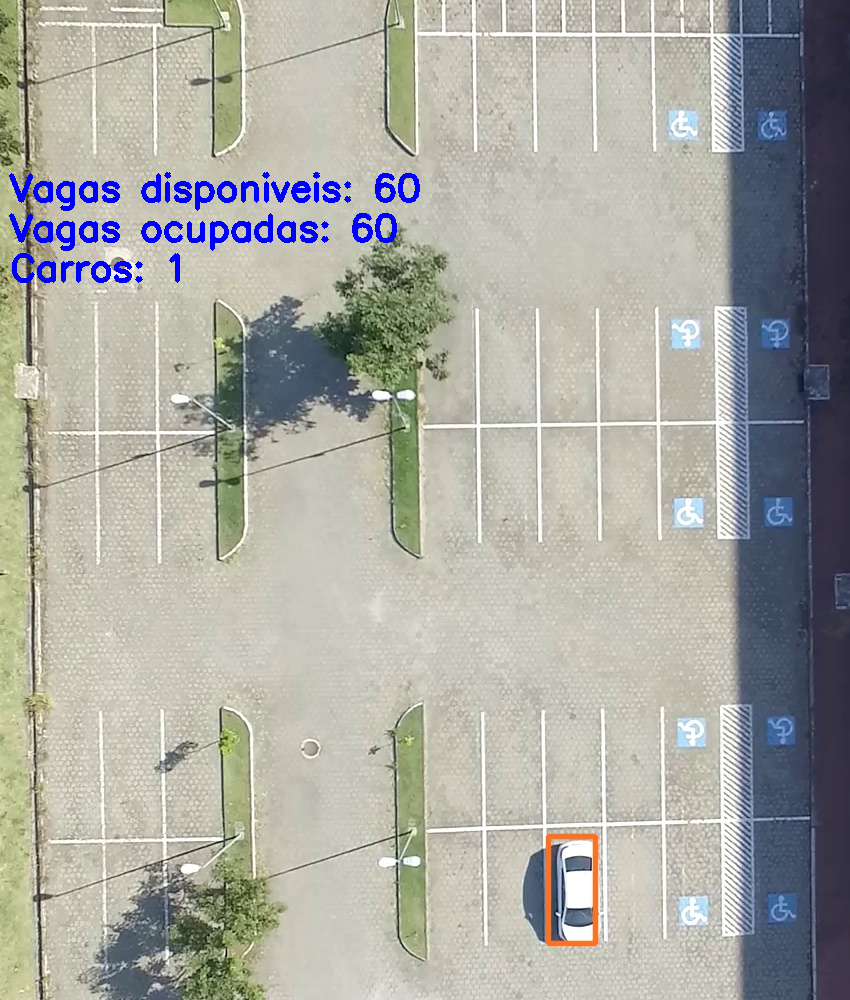

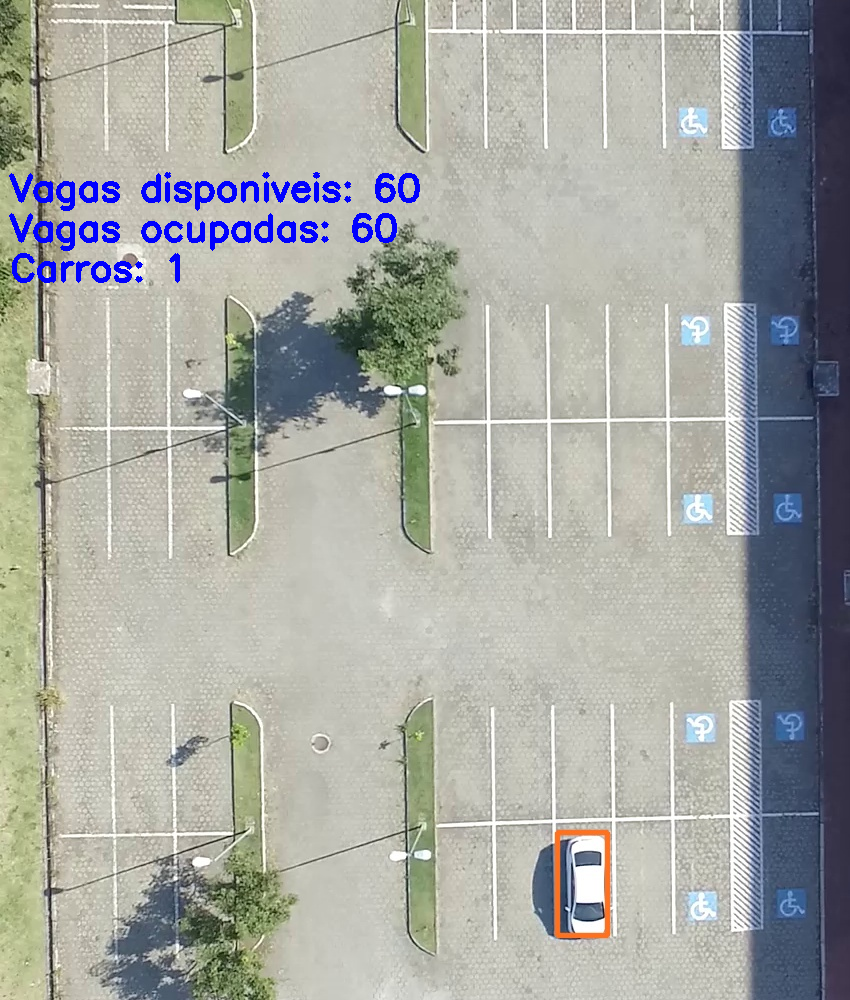

In [ ]:
pasta_teste = "/content/drive/MyDrive/Testes/teste_fold2_30"
teste(pasta_teste)

#Verificar sobreposição

Entendido o método para verificar o preenchimento de vagas aprimoramos e aplicamos para contruir uma tabela de retorno contendo as informações, agora, aplicado em um vídeo

In [ ]:
i2_1vagas_1 = [(20, 36, 46, 114), (77, 37, 49, 109), (135, 39, 47, 109), (395, 44, 42, 102), (448, 42, 44, 104), (505, 38, 47, 108), (562, 38, 47, 104), (620, 40, 48, 104), (708, 43, 46, 101)]
i2_2vagas_1 = [(26, 168, 40, 112), (76, 165, 49, 112), (139, 160, 44, 108), (395, 156, 41, 106), (447, 156, 50, 105), (509, 155, 44, 107), (568, 155, 45, 106), (624, 154, 49, 99), (709, 154, 54, 107)]
i2_3vagas_1 = [(23, 430, 50, 116), (85, 428, 48, 114), (147, 427, 45, 110), (399, 426, 49, 113), (460, 425, 46, 109), (518, 429, 45, 103), (575, 425, 52, 109), (634, 428, 51, 103), (720, 424, 51, 106)]
i2_4vagas_1 = [(28, 558, 47, 107), (88, 554, 49, 111), (151, 553, 40, 109), (401, 549, 49, 104), (458, 546, 51, 106), (520, 541, 49, 107), (580, 541, 47, 110), (635, 540, 52, 105), (723, 538, 52, 105)]
i2_5vagas_1 = [(42, 836, 37, 103), (90, 833, 55, 106), (156, 835, 48, 104), (417, 818, 42, 112), (468, 819, 46, 111), (526, 819, 48, 108), (583, 816, 52, 110), (645, 816, 46, 108), (727, 812, 47, 107)]
i2_6vagas_1 = [(42, 955, 38, 93), (93, 953, 50, 94), (157, 952, 48, 96), (415, 940, 43, 107), (472, 936, 44, 112), (528, 936, 49, 107), (586, 938, 49, 95), (647, 933, 46, 99), (734, 930, 41, 97)]

vagasi2_1 = [i2_1vagas_1, i2_2vagas_1, i2_3vagas_1, i2_4vagas_1, i2_5vagas_1, i2_6vagas_1]

In [ ]:
def ajustar_contraste(imagem, contraste, brilho):
    imagem_ajustada = cv2.convertScaleAbs(imagem, alpha=contraste, beta=brilho)
    return imagem_ajustada

In [ ]:
def printar_vagas(frame, vagas):

    for fileiraVagas in vagas:
        for x, y, w, h in fileiraVagas:
            cv2.rectangle(frame, (x, y), (x+w, y+h), (255, 0, 0), 2)

    return frame

In [ ]:
A2_video = ('/content/drive/MyDrive/TF_IA_DATA/A2_vid1.mp4')

In [ ]:
##Aqui pegamos o vídeo gerado pelo drone, cortamos, rotacionamos e ajustamos o contraste antes de aplicar o modelo
def processar_vid1(video1, nvideo, vagas, x1, x2, y1, y2, save_path):

    video = cv2.VideoCapture(video1)

    fps = video.get(cv2.CAP_PROP_FPS)
    width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))

    output_filename = f"/content/drive/MyDrive/Testes/Vids/video.mp4"
    fourcc = cv2.VideoWriter_fourcc(*"mp4v")
    output_video = cv2.VideoWriter(output_filename, fourcc, fps, (y2 - y1, x2 - x1))

    while True:

        ret, frame = video.read()

        if not ret:
            break

        frame = cv2.rotate(frame, cv2.ROTATE_90_CLOCKWISE)
        frame = frame[x1:x2, y1:y2]
        frame = ajustar_contraste(frame, 1.2, 20)


        ##framev = printar_vagas(frame, vagas)
        output_video.write(frame)
    video.release()
    output_video.release()


In [ ]:
output_path = "/content/drive/MyDrive/Testes/predict/video.mp4"
processar_vid1(A2_video, 1, vagasi2_1, 420, 1500, 0, 850, output_path)

In [ ]:
##Aplicando o modelo nos dados
!yolo task=detect mode=predict model=/content/drive/MyDrive/Treinos/train1/weights/best.pt conf=0.3 source=/content/drive/MyDrive/Testes/Vids/video.mp4 save_txt=true show_conf=true show_labels=true project=/content/drive/MyDrive/Testes iou=0.2

In [ ]:
#Agora com o vídeo cortado e com as caixas delimitadoras geradas pelo modelo, essa função pode ser utilizada para mostrar no video as boxes com a verdade das vagas -- Apenas para visualização e teste
def processar_vid2(video1, nvideo, vagas, save_path):

    video = cv2.VideoCapture(video1)

    fps = video.get(cv2.CAP_PROP_FPS)
    width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))

    output_filename = f"/content/drive/MyDrive/Testes/Vids/video_predict_space.mp4"
    fourcc = cv2.VideoWriter_fourcc(*"mp4v")
    output_video = cv2.VideoWriter(output_filename, fourcc, fps, (width, height), isColor=True)

    while True:

        ret, frame = video.read()

        if not ret:
            break

        framev = printar_vagas(frame, vagas)
        output_video.write(framev)
    video.release()
    output_video.release()

In [ ]:
processar_vid2('/content/drive/MyDrive/Testes/predict/video.avi', 1, vagasi2_1, output_path)

Processando o vídeo do modelo para colocarmos a tabela de informações

Aplicação final da verificação de sobreposição

In [ ]:
def ler_coordenadas(file_path):
    with open(file_path, 'r') as file:
        coordinates = []
        for line in file:
            parts = line.strip().split()
            if len(parts) == 5:
                x = float(parts[1])
                y = float(parts[2])
                width = float(parts[3])
                height = float(parts[4])
                coordinates.append((x, y, width, height))
    return coordinates

In [ ]:
def checar_sobreposição(coord1, coord2):
    x1, y1, w1, h1 = coord1
    x2, y2, w2, h2 = coord2
    if x1 < x2 + w2 and x1 + w1 > x2 and y1 < y2 + h2 and y1 + h1 > y2:
        return True
    return False

In [ ]:
def contar_vagas_preenchidas(pred_coordinates, true_coordinates):
    filled_vagas = 0
    for pred_coord in pred_coordinates:
        for true_coord in true_coordinates:
            if check_overlap(pred_coord, true_coord):
                filled_vagas += 1
                break
    return filled_vagas

In [ ]:
def tabela(frame, vagas_total, vagas_disp, vagas_preenchidas, carros):
    # Definir fonte e tamanho do texto
    fonte = cv2.FONT_HERSHEY_SIMPLEX
    tamanho_texto = 0.8
    espessura_texto = 2

    # Definir as coordenadas do texto na imagem
    coordenadas_texto_vagasdisp = (10, 330)
    coordenadas_texto_vagasocup = (10, 360)
    coordenadas_texto_carros = (10, 390)

    # Desenhar os textos na imagem
    cv2.putText(frame, f"Vagas disponiveis: {vagas_disp}", coordenadas_texto_vagasdisp, fonte, tamanho_texto, (0, 255, 0), espessura_texto, cv2.LINE_AA)
    cv2.putText(frame, f"Vagas ocupadas: {vagas_preenchidas}", coordenadas_texto_vagasocup, fonte, tamanho_texto, (0, 255, 0), espessura_texto, cv2.LINE_AA)
    cv2.putText(frame, f"Carros aqui: {carros}", coordenadas_texto_carros, fonte, tamanho_texto, (0, 255, 0), espessura_texto, cv2.LINE_AA)

    return frame

In [ ]:
def processar_vid3(video_path, output_path, vagas_total):
    video = cv2.VideoCapture(video_path)
    width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = video.get(cv2.CAP_PROP_FPS)
    total_frames = int(video.get(cv2.CAP_PROP_FRAME_COUNT))

    output_frames = []
    vagas_disp = vagas_total
    vagas_preenchidas = 0

    labels_directory = "/content/drive/MyDrive/Testes/predict/labels"
    for frame_index in range(total_frames):
        ret, frame = video.read()
        if not ret:
            break

        pred_coordinates = read_coordinates(os.path.join(labels_directory, f"video_{frame_index + 1}.txt"))
        true_coordinates = read_coordinates("/content/drive/MyDrive/BBOX+TAMIMG/A2vid1.txt")

        vagas_preenchidas = count_filled_vagas(pred_coordinates, true_coordinates)
        vagas_disp = vagas_total - vagas_preenchidas

        frame_with_table = tabelaA2(frame, vagas_total, vagas_disp, vagas_preenchidas, str(len(pred_coordinates)))
        output_frames.append(frame_with_table)

    output_filename = os.path.join(output_path, "video_predict_space.mp4")
    height, width, _ = output_frames[0].shape
    fourcc = cv2.VideoWriter_fourcc(*"mp4v")
    out = cv2.VideoWriter(output_filename, fourcc, fps, (width, height))
    for frame in output_frames:
        out.write(frame)
    out.release()

In [ ]:
# Define o caminho do vídeo, o número total de vagas no video e o caminho de saída
video_path = "/content/drive/MyDrive/Testes/predict/video.avi"
vagas_total = 54
output_path = "/content/drive/MyDrive/Testes/Vids"

# Chama a função para processar o vídeo e salvar no caminho de saída
processar_vid3(video_path, output_path, vagas_total)